In [1]:
#from google.colab import drive
#drive.mount('/content/drive/')

In [2]:
#!pip install mne

In [3]:
import scipy.io as sio
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from scipy import signal
import math
import mne
import seaborn as sns
%matplotlib inline

In [4]:
epochs = mne.read_epochs('Data/subsampl_part_A_epo.fif')
epochs.info

Reading /home/jovyan/work/Code/Benchmark/Data/subsampl_part_A_epo.fif ...
    Found the data of interest:
        t =    -304.00 ...     688.00 ms
        0 CTF compensation matrices available
Reading /home/jovyan/work/Code/Benchmark/Data/subsampl_part_A_epo-1.fif ...
    Found the data of interest:
        t =    -304.00 ...     688.00 ms
        0 CTF compensation matrices available
Not setting metadata
192855 matching events found
No baseline correction applied
0 projection items activated


<Info | 10 non-empty values
 bads: []
 ch_names: FC5, FC3, FC1, C5, C3, C1, Cz, CP5, CP3, CP1, CPz, P1, PO7, PO3, ...
 chs: 32 EEG
 custom_ref_applied: False
 dig: 35 items (3 Cardinal, 32 EEG)
 file_id: 4 items (dict)
 highpass: 0.1 Hz
 lowpass: 15.0 Hz
 meas_date: 2019-11-06 15:29:57 UTC
 meas_id: 4 items (dict)
 nchan: 32
 projs: []
 sfreq: 125.0 Hz
>

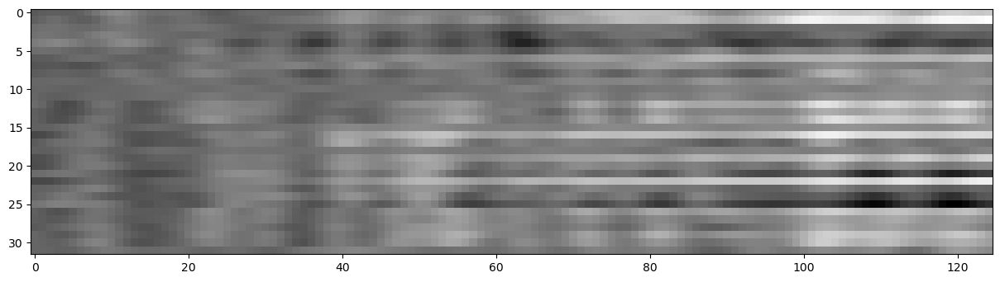

In [5]:
plt.figure(1, figsize=(15, 7))
plt.imshow(np.squeeze(epochs["P300"][6].get_data()), cmap=plt.cm.gray_r, interpolation='nearest')

plt.show()

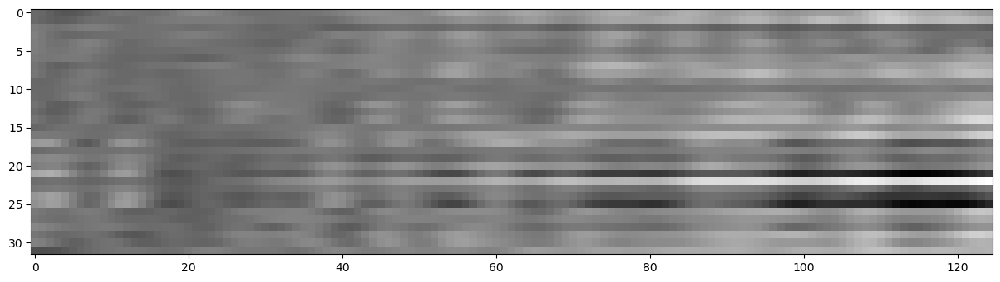

In [8]:
plt.figure(1, figsize=(15, 7))
plt.imshow(np.squeeze(epochs["col2"][6].get_data()), cmap=plt.cm.gray_r, interpolation='nearest')

plt.show()

In [9]:
target = epochs["P300"].pick_channels(['Oz','Cz','Pz','Fz'])#.average()
#target.get_data()

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).


/tmp/ipykernel_98499/3869092284.py:1: FutureWarning: The default for pick_channels will change from ordered=False to ordered=True in 1.5 and this will result in a change of behavior because the resulting channel order will not match. Either use a channel order that matches your instance or pass ordered=False.
  target = epochs["P300"].pick_channels(['Oz','Cz','Pz','Fz'])#.average()


In [10]:
standard = epochs["col2"].pick_channels(['Oz','Cz','Pz','Fz'])#.average()
standard

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).


/tmp/ipykernel_98499/499467555.py:1: FutureWarning: The default for pick_channels will change from ordered=False to ordered=True in 1.5 and this will result in a change of behavior because the resulting channel order will not match. Either use a channel order that matches your instance or pass ordered=False.
  standard = epochs["col2"].pick_channels(['Oz','Cz','Pz','Fz'])#.average()


Number of events,14835
Events,col2: 14835
Time range,-0.304 – 0.688 s
Baseline,-0.300 – 0.000 s


In [11]:
def ventanas_mean(epochs,m1,m2,m3,m4,F):
  epochs_part1 = epochs.copy().crop(tmin=m1, tmax=m2)
  epochs_part2 = epochs.copy().crop(tmin=m2, tmax=m3)
  epochs_part3 = epochs.copy().crop(tmin=m3, tmax=m4)
  epochs_part4 = epochs.copy().crop(tmin=m4, tmax=F)
  data_part1 = epochs_part1.get_data()
  data_part2 = epochs_part2.get_data()
  data_part3 = epochs_part3.get_data()
  data_part4 = epochs_part4.get_data()
  mean_part1 = np.mean(data_part1[:, :], axis=2)
  mean_part2 = np.mean(data_part2[:, :], axis=2)
  mean_part3 = np.mean(data_part3[:, :], axis=2)
  mean_part4 = np.mean(data_part4[:, :], axis=2)
  return mean_part1, mean_part2, mean_part3, mean_part4

In [12]:
mean_target_part1, mean_target_part2 ,mean_target_part3 ,mean_target_part4 = ventanas_mean(target,-0.3,0,0.25,0.4,0.7)
mean_target_part1.shape, mean_target_part2.shape ,mean_target_part3.shape ,mean_target_part4.shape

/tmp/ipykernel_98499/3706020052.py:5: RuntimeWarning: tmax is not in time interval. tmax is set to <class 'mne.epochs.EpochsFIF'>.tmax (0.688 s)
  epochs_part4 = epochs.copy().crop(tmin=m4, tmax=F)


((14835, 4), (14835, 4), (14835, 4), (14835, 4))

In [13]:
mean_standard_part1, mean_standard_part2, mean_standard_part3, mean_standard_part4 = ventanas_mean(standard,-0.3,0,0.25,0.4,0.7)
mean_standard_part1.shape, mean_standard_part2.shape, mean_standard_part3.shape, mean_standard_part4.shape

/tmp/ipykernel_98499/3706020052.py:5: RuntimeWarning: tmax is not in time interval. tmax is set to <class 'mne.epochs.EpochsFIF'>.tmax (0.688 s)
  epochs_part4 = epochs.copy().crop(tmin=m4, tmax=F)


((14835, 4), (14835, 4), (14835, 4), (14835, 4))

In [14]:
print(mean_target_part1.shape)
print(mean_standard_part1.shape)
featuresT = np.concatenate((mean_target_part1, mean_target_part2, mean_target_part3, mean_target_part4), axis=1)
featuresF = np.concatenate((mean_standard_part1, mean_standard_part2, mean_standard_part3, mean_standard_part4), axis=1)
print(featuresT.shape)
print(featuresF.shape)

(14835, 4)
(14835, 4)
(14835, 16)
(14835, 16)


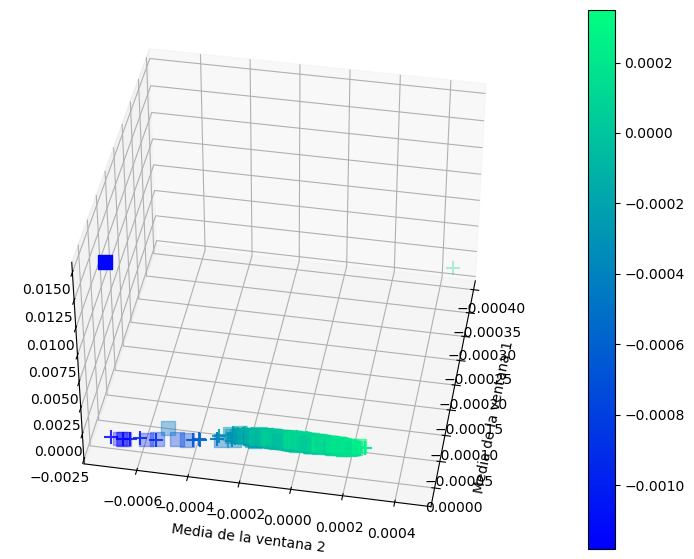

In [15]:
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.pyplot as plt
import numpy as np

fig = plt.figure(figsize =(10, 7))
ax = fig.add_subplot(111, projection='3d')

x = mean_target_part1[:,1]
y = mean_target_part2[:,1]
z = mean_target_part4[:,1]
c = mean_target_part3[:,1]

x1 = mean_standard_part1[:,1]
y1 = mean_standard_part2[:,1]
z1 = mean_standard_part4[:,1]
c1 = mean_standard_part3[:,1]

img2 = ax.scatter(x1, y1, z1, c=c1, s = 100, marker = "s", cmap=plt.winter())
fig.colorbar(img2)

plt.xlabel('Media de la ventana 1')
plt.ylabel('Media de la ventana 2')
plt.clabel('Media de la ventana 3')


img = ax.scatter(x, y, z, c=c, s = 100,marker = "+", cmap=plt.winter())
ax.view_init(40, 10)
#fig.colorbar(img,img2)
plt.show()

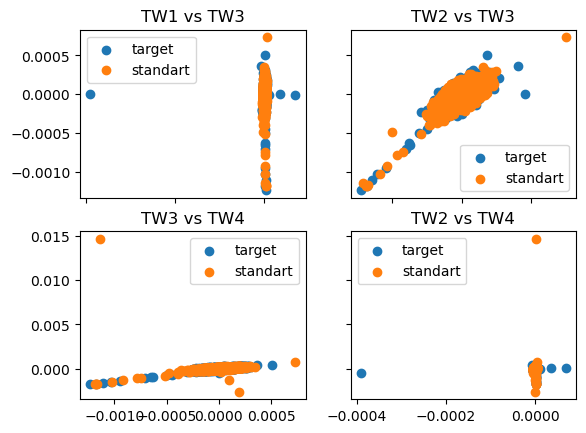

In [16]:
fig, axs = plt.subplots(2, 2)
axs[0, 0].scatter(mean_target_part1,mean_target_part3, label = 'target')
axs[0, 0].scatter(mean_standard_part1,mean_standard_part3, label = 'standart')
axs[0, 0].set_title('TW1 vs TW3')
axs[0, 0].legend()
axs[0, 1].scatter(mean_target_part2,mean_target_part3, label = 'target')
axs[0, 1].scatter(mean_standard_part2,mean_standard_part3, label = 'standart')
axs[0, 1].set_title('TW2 vs TW3')
axs[0, 1].legend()
axs[1, 0].scatter(mean_target_part3, mean_target_part4, label = 'target')
axs[1, 0].scatter(mean_standard_part3, mean_standard_part4, label = 'standart')
axs[1, 0].set_title('TW3 vs TW4')
axs[1, 0].legend()
axs[1, 1].scatter(mean_target_part1,mean_target_part4, label = 'target')
axs[1, 1].scatter(mean_standard_part1,mean_standard_part4, label = 'standart')
axs[1, 1].set_title('TW2 vs TW4')
axs[1, 1].legend()


# Hide x labels and tick labels for top plots and y ticks for right plots.
for ax in axs.flat:
    ax.label_outer()

14835


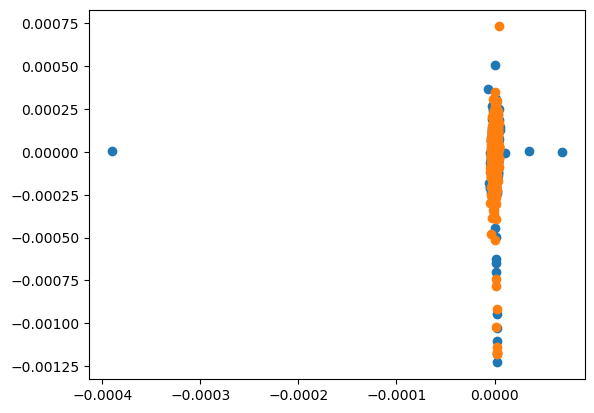

In [17]:
print(len(mean_target_part1))
plt.scatter(mean_target_part1,mean_target_part3)
plt.scatter(mean_standard_part1,mean_standard_part3)

In [18]:
labelT = np.ones([len(mean_target_part1)])
labelF = np.zeros([len(mean_standard_part1)])
print(labelT.shape)
print(labelF.shape)

(14835,)
(14835,)


In [19]:
features = np.concatenate((featuresT,featuresF), axis=0)
labels = np.concatenate((labelT,labelF), axis=0)

print(features.shape)
print(labels.shape)

(29670, 16)
(29670,)


In [20]:
import seaborn as sns
data_df = pd.DataFrame(features)
#data_df.columns = ["M ventana 1", "M ventana 2", "M ventana 3","M ventana 4"]
data_df['P300'] =labels


/opt/conda/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dty

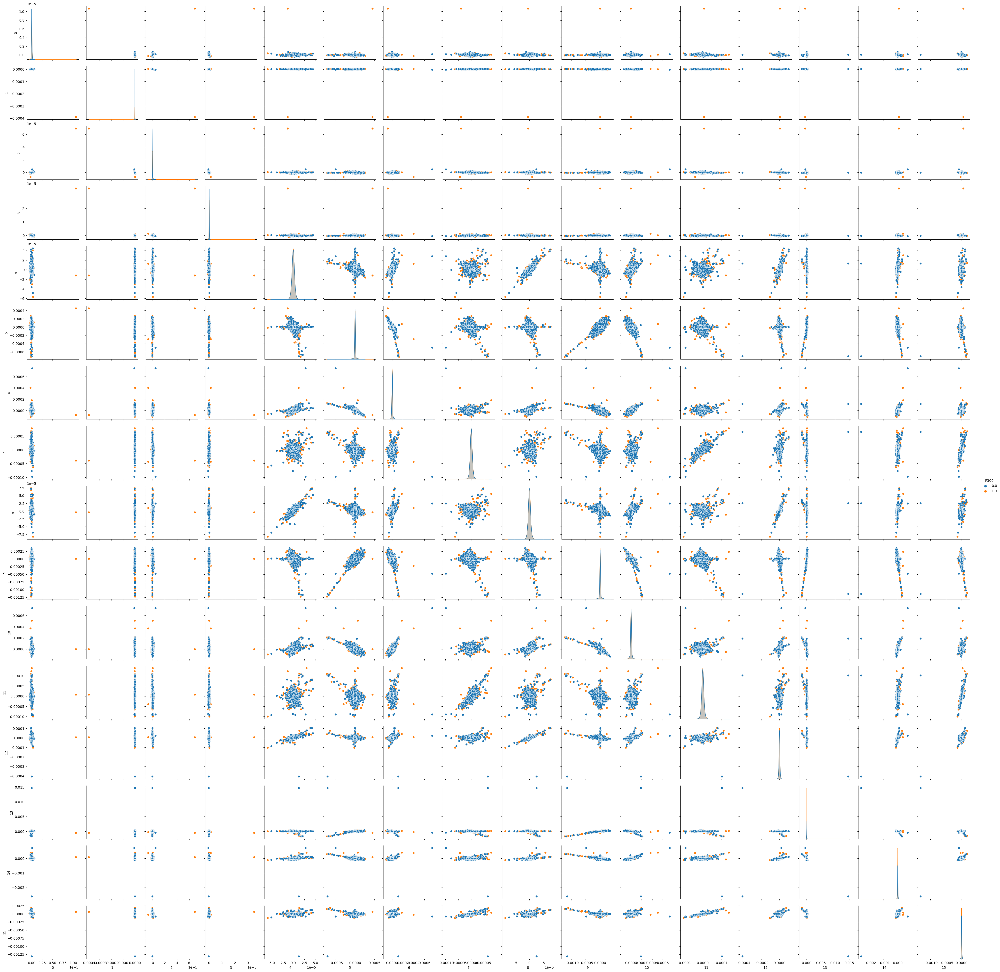

In [21]:
sns.pairplot(data_df, hue="P300", diag_kws={'bw': 0.2})

In [22]:
#from sklearn.feature_selection import VarianceThreshold
#sel = VarianceThreshold(threshold=(.8 * (1 - .8))) # la varianza para una distribucción binomial es Var(x)=p(1-p)
#sel.fit_transform(data_df)

In [23]:
#from sklearn.feature_selection import SelectKBest
#from sklearn.feature_selection import f_classif
#X_new = SelectKBest(f_classif, k=64).fit_transform(X, y) # Utiliza f_test para clasificación
#X_new

In [24]:
#from sklearn.feature_selection import SelectKBest, f_classif

#selector = SelectKBest(f_classif, k=64)
#selector.fit(X_train, y_train)
#scores = -np.log10(selector.pvalues_)
#scores /= scores.max()

## Electrodos promediados

In [25]:
epochs = mne.read_epochs('Data/elect_mean_part_A_epo.fif')
epochs.info

Reading /home/jovyan/work/Code/Benchmark/Data/elect_mean_part_A_epo.fif ...
Isotrak not found
    Found the data of interest:
        t =    -304.00 ...     688.00 ms
        0 CTF compensation matrices available
Not setting metadata
192855 matching events found
No baseline correction applied
0 projection items activated


<Info | 9 non-empty values
 bads: []
 ch_names: O, C, P, F
 chs: 4 EEG
 custom_ref_applied: False
 file_id: 4 items (dict)
 highpass: 0.0 Hz
 lowpass: 62.5 Hz
 meas_date: unspecified
 meas_id: 4 items (dict)
 nchan: 4
 projs: []
 sfreq: 125.0 Hz
>

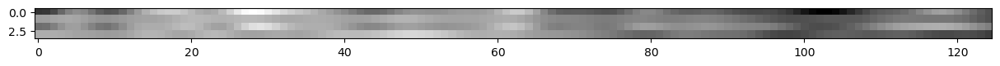

In [26]:
plt.figure(1, figsize=(15, 7))
plt.imshow(np.squeeze(epochs["14"][1].get_data()), cmap=plt.cm.gray_r, interpolation='nearest')

plt.show()

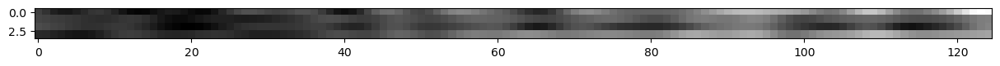

In [27]:
plt.figure(1, figsize=(15, 7))
plt.imshow(np.squeeze(epochs["2"][6].get_data()), cmap=plt.cm.gray_r, interpolation='nearest')

plt.show()

In [29]:
target = epochs["14"]#.average()
#target.get_data()

In [30]:
standard = epochs["2"]#.average()
standard

Number of events,14835
Events,2: 14835
Time range,-0.304 – 0.688 s
Baseline,off


In [31]:
mean_target_part1, mean_target_part2 ,mean_target_part3 ,mean_target_part4 = ventanas_mean(target,-0.3,0,0.25,0.4,0.7)
mean_target_part1.shape, mean_target_part2.shape ,mean_target_part3.shape ,mean_target_part4.shape

/tmp/ipykernel_98499/3706020052.py:5: RuntimeWarning: tmax is not in time interval. tmax is set to <class 'mne.epochs.EpochsFIF'>.tmax (0.688 s)
  epochs_part4 = epochs.copy().crop(tmin=m4, tmax=F)


((14835, 4), (14835, 4), (14835, 4), (14835, 4))

In [32]:
mean_standard_part1, mean_standard_part2, mean_standard_part3, mean_standard_part4 = ventanas_mean(standard,-0.3,0,0.25,0.4,0.7)
mean_standard_part1.shape, mean_standard_part2.shape, mean_standard_part3.shape, mean_standard_part4.shape

/tmp/ipykernel_98499/3706020052.py:5: RuntimeWarning: tmax is not in time interval. tmax is set to <class 'mne.epochs.EpochsFIF'>.tmax (0.688 s)
  epochs_part4 = epochs.copy().crop(tmin=m4, tmax=F)


((14835, 4), (14835, 4), (14835, 4), (14835, 4))

In [33]:
featuresT = np.concatenate((mean_target_part1, mean_target_part2, mean_target_part3, mean_target_part4), axis=1)
featuresF = np.concatenate((mean_standard_part1, mean_standard_part2, mean_standard_part3, mean_standard_part4), axis=1)

In [34]:
labelT = np.ones([len(mean_target_part1)])
labelF = np.zeros([len(mean_standard_part1)])

In [35]:
features = np.concatenate((featuresT,featuresF), axis=0)
labels = np.concatenate((labelT,labelF), axis=0)

print(features.shape)
print(labels.shape)

(29670, 16)
(29670,)


In [36]:
data_df = pd.DataFrame(features)
data_df['P300'] =labels

/opt/conda/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dty

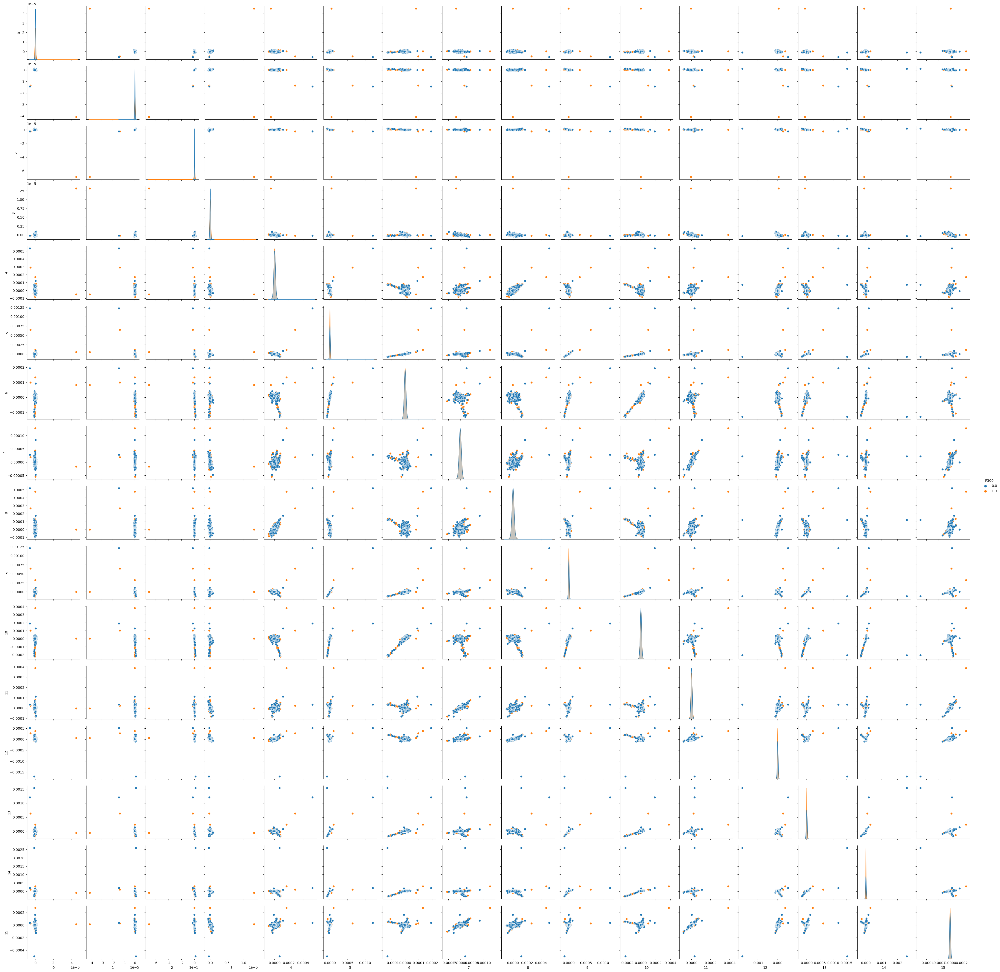

In [37]:
sns.pairplot(data_df, hue="P300", diag_kws={'bw': 1})

## Electrodos promediados cuadrados

In [38]:
def ventanas_exp2(epochs,m1,m2,m3,m4,F):
  epochs_part1 = epochs.copy().crop(tmin=m1, tmax=m2)
  epochs_part2 = epochs.copy().crop(tmin=m2, tmax=m3)
  epochs_part3 = epochs.copy().crop(tmin=m3, tmax=m4)
  epochs_part4 = epochs.copy().crop(tmin=m4, tmax=F)
  data_part1 = epochs_part1.get_data()
  data_part2 = epochs_part2.get_data()
  data_part3 = epochs_part3.get_data()
  data_part4 = epochs_part4.get_data()
  mean_part1 = np.mean(data_part1[:, :]**2, axis=2)
  mean_part2 = np.mean(data_part2[:, :]**2, axis=2)
  mean_part3 = np.mean(data_part3[:, :]**2, axis=2)
  mean_part4 = np.mean(data_part4[:, :]**2, axis=2)
  return mean_part1, mean_part2, mean_part3, mean_part4

In [39]:
mean_target_part1, mean_target_part2 ,mean_target_part3 ,mean_target_part4 = ventanas_exp2(target,-0.3,0,0.25,0.4,0.7)

/tmp/ipykernel_98499/2608368029.py:5: RuntimeWarning: tmax is not in time interval. tmax is set to <class 'mne.epochs.EpochsFIF'>.tmax (0.688 s)
  epochs_part4 = epochs.copy().crop(tmin=m4, tmax=F)


In [40]:
mean_standard_part1, mean_standard_part2, mean_standard_part3, mean_standard_part4 = ventanas_mean(standard,-0.3,0,0.25,0.4,0.7)
mean_standard_part1.shape

/tmp/ipykernel_98499/3706020052.py:5: RuntimeWarning: tmax is not in time interval. tmax is set to <class 'mne.epochs.EpochsFIF'>.tmax (0.688 s)
  epochs_part4 = epochs.copy().crop(tmin=m4, tmax=F)


(14835, 4)

In [41]:
featuresT = np.concatenate((mean_target_part1, mean_target_part2, mean_target_part3, mean_target_part4), axis=1)
featuresF = np.concatenate((mean_standard_part1, mean_standard_part2, mean_standard_part3, mean_standard_part4), axis=1)
labelT = np.ones([len(mean_target_part1)])
labelF = np.zeros([len(mean_standard_part1)])

In [42]:
features = np.concatenate((featuresT,featuresF), axis=0)
labels = np.concatenate((labelT,labelF), axis=0)

print(features.shape)
print(labels.shape)

(29670, 16)
(29670,)


In [43]:
data_df = pd.DataFrame(features)
data_df['P300'] =labels

/opt/conda/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dty

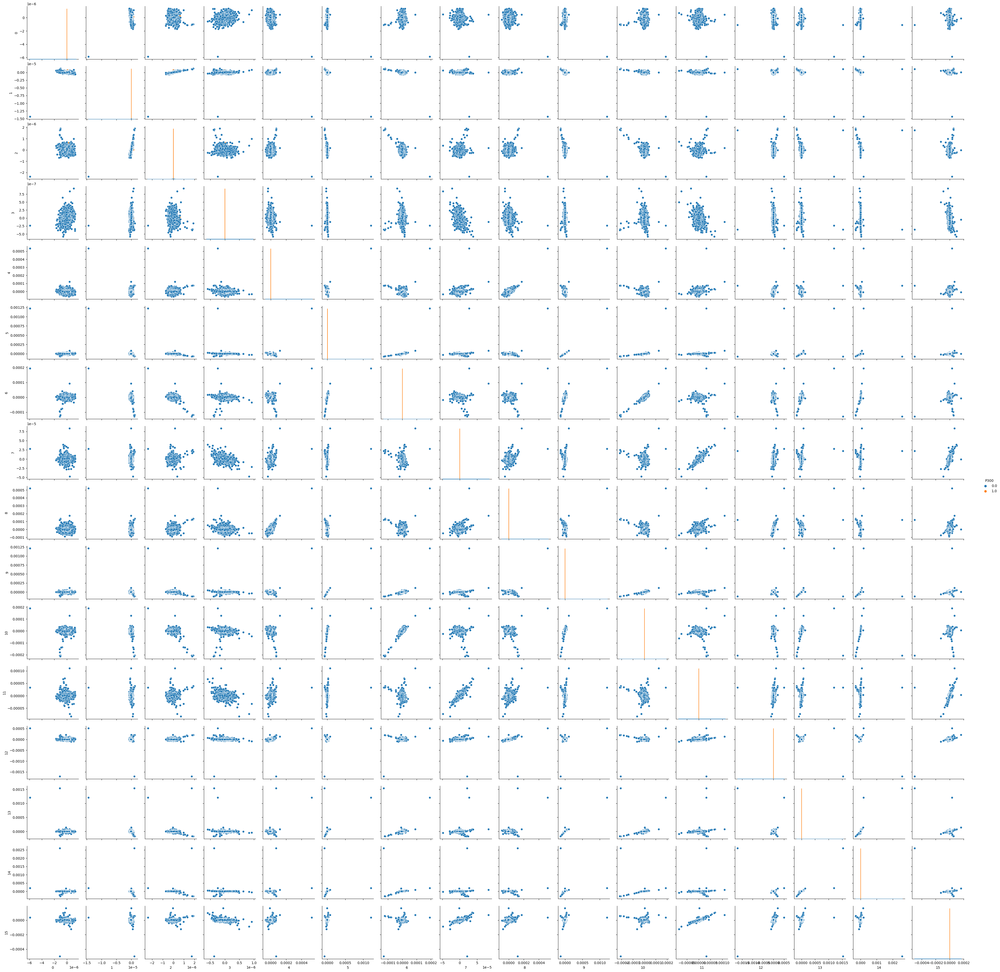

In [44]:
sns.pairplot(data_df, hue="P300", diag_kws={'bw': 0.2})

## Rango Intercuartil

In [45]:
def ventanas_IQR(epochs,m1,m2,m3,m4,F):
  epochs_part1 = epochs.copy().crop(tmin=m1, tmax=m2)
  epochs_part2 = epochs.copy().crop(tmin=m2, tmax=m3)
  epochs_part3 = epochs.copy().crop(tmin=m3, tmax=m4)
  epochs_part4 = epochs.copy().crop(tmin=m4, tmax=F)
  data_part1 = epochs_part1.get_data()
  data_part2 = epochs_part2.get_data()
  data_part3 = epochs_part3.get_data()
  data_part4 = epochs_part4.get_data()
  mean_part1 = np.percentile(data_part1[:, :],75, axis=2)-np.percentile(data_part1[:, :],25, axis=2)
  mean_part2 = np.percentile(data_part2[:, :],75, axis=2)-np.percentile(data_part2[:, :],25, axis=2)
  mean_part3 = np.percentile(data_part3[:, :],75, axis=2)-np.percentile(data_part3[:, :],25, axis=2)
  mean_part4 = np.percentile(data_part4[:, :],75, axis=2)-np.percentile(data_part4[:, :],25, axis=2)
  return mean_part1, mean_part2, mean_part3, mean_part4

In [46]:
mean_target_part1, mean_target_part2 ,mean_target_part3 ,mean_target_part4 = ventanas_IQR(target,-0.3,0,0.25,0.4,0.7)
mean_standard_part1, mean_standard_part2, mean_standard_part3, mean_standard_part4 = ventanas_IQR(standard,-0.3,0,0.25,0.4,0.7)
mean_standard_part1.shape

/tmp/ipykernel_98499/934145590.py:5: RuntimeWarning: tmax is not in time interval. tmax is set to <class 'mne.epochs.EpochsFIF'>.tmax (0.688 s)
  epochs_part4 = epochs.copy().crop(tmin=m4, tmax=F)
/tmp/ipykernel_98499/934145590.py:5: RuntimeWarning: tmax is not in time interval. tmax is set to <class 'mne.epochs.EpochsFIF'>.tmax (0.688 s)
  epochs_part4 = epochs.copy().crop(tmin=m4, tmax=F)


(14835, 4)

In [47]:
featuresT = np.concatenate((mean_target_part1, mean_target_part2, mean_target_part3, mean_target_part4), axis=1)
featuresF = np.concatenate((mean_standard_part1, mean_standard_part2, mean_standard_part3, mean_standard_part4), axis=1)
labelT = np.ones([len(mean_target_part1)])
labelF = np.zeros([len(mean_standard_part1)])

In [48]:
features = np.concatenate((featuresT,featuresF), axis=0)
labels = np.concatenate((labelT,labelF), axis=0)

print(features.shape)
print(labels.shape)

(29670, 16)
(29670,)


In [49]:
data_df = pd.DataFrame(features)
data_df['P300'] =labels

/opt/conda/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dty

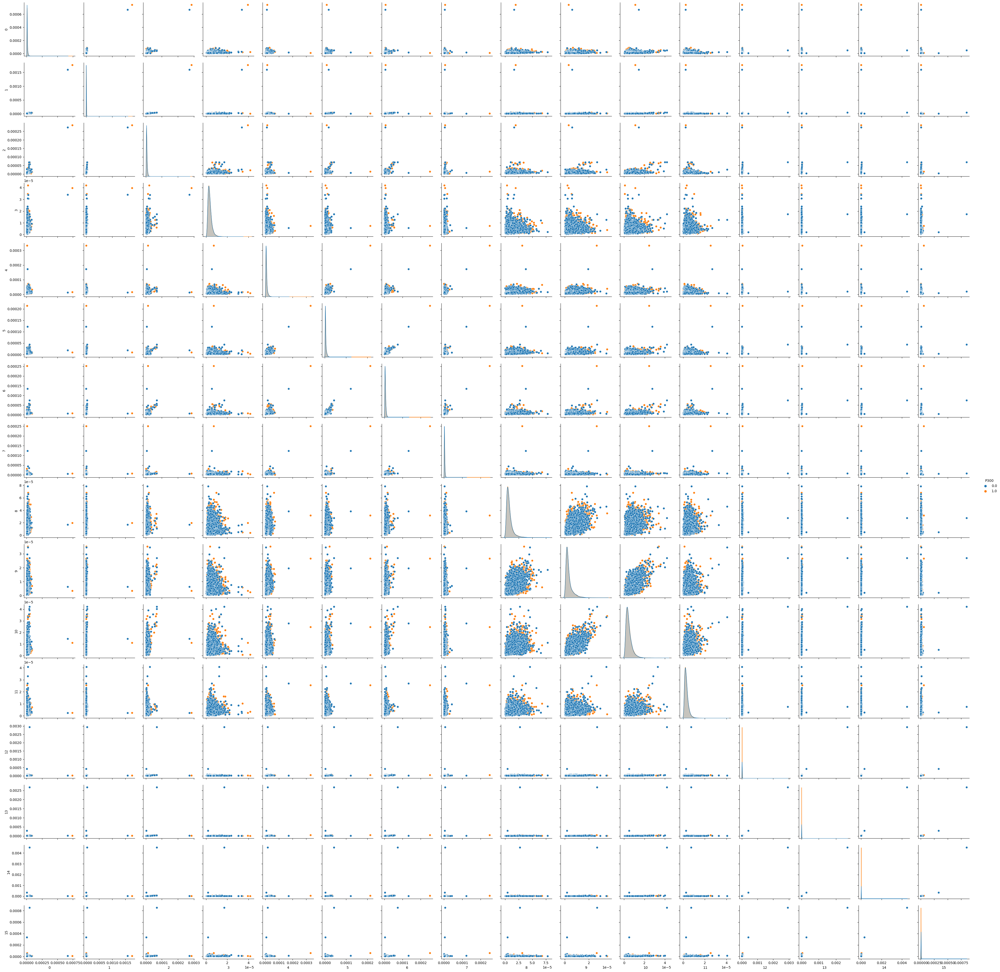

In [50]:
sns.pairplot(data_df, hue="P300", diag_kws={'bw': 0.2})

## Desviación estandar

In [51]:
def ventanas_STR(epochs,m1,m2,m3,m4,F):
  epochs_part1 = epochs.copy().crop(tmin=m1, tmax=m2)
  epochs_part2 = epochs.copy().crop(tmin=m2, tmax=m3)
  epochs_part3 = epochs.copy().crop(tmin=m3, tmax=m4)
  epochs_part4 = epochs.copy().crop(tmin=m4, tmax=F)
  data_part1 = epochs_part1.get_data()
  data_part2 = epochs_part2.get_data()
  data_part3 = epochs_part3.get_data()
  data_part4 = epochs_part4.get_data()
  mean_part1 = np.std(data_part1[:, :], axis=2)
  mean_part2 = np.std(data_part2[:, :], axis=2)
  mean_part3 = np.std(data_part3[:, :], axis=2)
  mean_part4 = np.std(data_part4[:, :], axis=2)
  return mean_part1, mean_part2, mean_part3, mean_part4

In [52]:
mean_target_part1, mean_target_part2 ,mean_target_part3 ,mean_target_part4 = ventanas_STR(target,-0.3,0,0.25,0.4,0.7)
mean_standard_part1, mean_standard_part2, mean_standard_part3, mean_standard_part4 = ventanas_STR(standard,-0.3,0,0.25,0.4,0.7)
mean_standard_part1.shape

/tmp/ipykernel_98499/2475158956.py:5: RuntimeWarning: tmax is not in time interval. tmax is set to <class 'mne.epochs.EpochsFIF'>.tmax (0.688 s)
  epochs_part4 = epochs.copy().crop(tmin=m4, tmax=F)
/tmp/ipykernel_98499/2475158956.py:5: RuntimeWarning: tmax is not in time interval. tmax is set to <class 'mne.epochs.EpochsFIF'>.tmax (0.688 s)
  epochs_part4 = epochs.copy().crop(tmin=m4, tmax=F)


(14835, 4)

In [53]:
featuresT = np.concatenate((mean_target_part1, mean_target_part2, mean_target_part3, mean_target_part4), axis=1)
featuresF = np.concatenate((mean_standard_part1, mean_standard_part2, mean_standard_part3, mean_standard_part4), axis=1)
labelT = np.ones([len(mean_target_part1)])
labelF = np.zeros([len(mean_standard_part1)])
features = np.concatenate((featuresT,featuresF), axis=0)
labels = np.concatenate((labelT,labelF), axis=0)

print(features.shape)
print(labels.shape)

(29670, 16)
(29670,)


In [54]:
data_df = pd.DataFrame(features)
data_df['P300'] =labels

/opt/conda/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dty

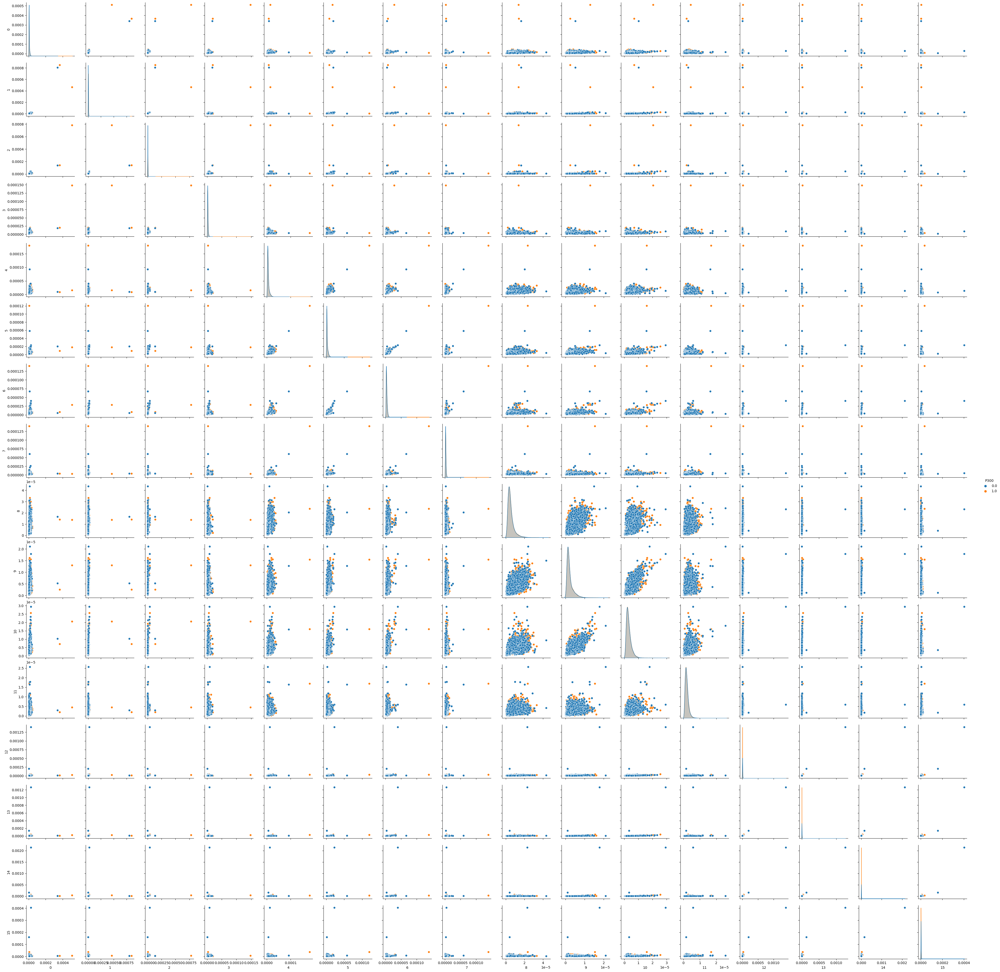

In [55]:
sns.pairplot(data_df, hue="P300", diag_kws={'bw': 0.2})

## Desviación máxima

In [56]:
def ventanas_maxSTR(epochs,m1,m2,m3,m4,F):
  std = np.std(epochs.get_data())
  epochs_part1 = epochs.copy().crop(tmin=m1, tmax=m2)
  epochs_part2 = epochs.copy().crop(tmin=m2, tmax=m3)
  epochs_part3 = epochs.copy().crop(tmin=m3, tmax=m4)
  epochs_part4 = epochs.copy().crop(tmin=m4, tmax=F)
  data_part1 = epochs_part1.get_data()
  data_part2 = epochs_part2.get_data()
  data_part3 = epochs_part3.get_data()
  data_part4 = epochs_part4.get_data()
  mean_part1 = np.max(data_part1[:, :], axis=2)/std
  mean_part2 = np.max(data_part2[:, :], axis=2)/std
  mean_part3 = np.max(data_part3[:, :], axis=2)/std
  mean_part4 = np.max(data_part4[:, :], axis=2)/std
  return mean_part1, mean_part2, mean_part3, mean_part4

In [57]:
mean_target_part1, mean_target_part2 ,mean_target_part3 ,mean_target_part4 = ventanas_maxSTR(target,-0.3,0,0.25,0.4,0.7)
mean_standard_part1, mean_standard_part2, mean_standard_part3, mean_standard_part4 = ventanas_maxSTR(standard,-0.3,0,0.25,0.4,0.7)
mean_standard_part1.shape

/tmp/ipykernel_98499/1895853730.py:6: RuntimeWarning: tmax is not in time interval. tmax is set to <class 'mne.epochs.EpochsFIF'>.tmax (0.688 s)
  epochs_part4 = epochs.copy().crop(tmin=m4, tmax=F)
/tmp/ipykernel_98499/1895853730.py:6: RuntimeWarning: tmax is not in time interval. tmax is set to <class 'mne.epochs.EpochsFIF'>.tmax (0.688 s)
  epochs_part4 = epochs.copy().crop(tmin=m4, tmax=F)


(14835, 4)

In [58]:
featuresT = np.concatenate((mean_target_part1, mean_target_part2, mean_target_part3, mean_target_part4), axis=1)
featuresF = np.concatenate((mean_standard_part1, mean_standard_part2, mean_standard_part3, mean_standard_part4), axis=1)
labelT = np.ones([len(mean_target_part1)])
labelF = np.zeros([len(mean_standard_part1)])

In [59]:
features = np.concatenate((featuresT,featuresF), axis=0)
labels = np.concatenate((labelT,labelF), axis=0)

print(features.shape)
print(labels.shape)

(29670, 16)
(29670,)


In [60]:
data_df = pd.DataFrame(features)
data_df['P300'] =labels

/opt/conda/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dty

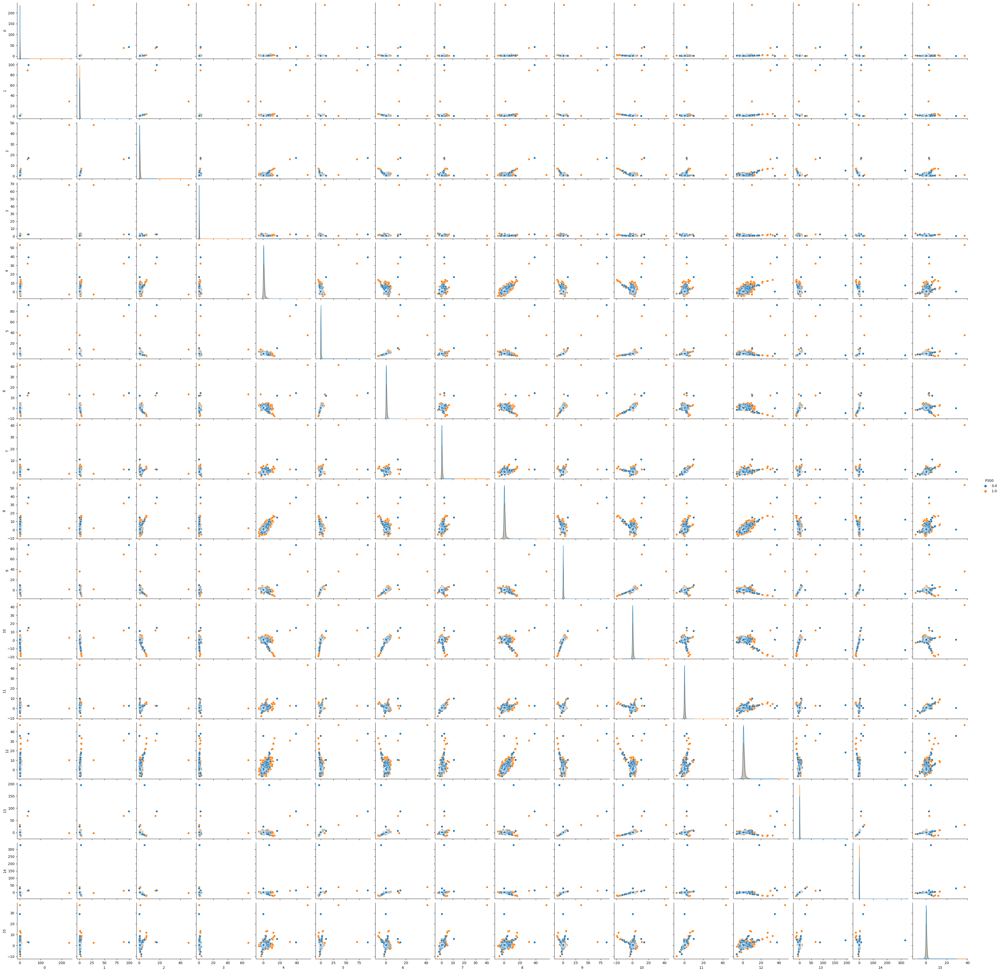

In [61]:
sns.pairplot(data_df, hue="P300", diag_kws={'bw': 0.2})

## Coeficiente de Variación

In [62]:
def ventanas_CV(epochs,m1,m2,m3,m4,F):
  prom = np.mean(epochs.get_data()) # Si pongo este parametro la distribución cambia   , axis=2
  epochs_part1 = epochs.copy().crop(tmin=m1, tmax=m2)
  epochs_part2 = epochs.copy().crop(tmin=m2, tmax=m3)
  epochs_part3 = epochs.copy().crop(tmin=m3, tmax=m4)
  epochs_part4 = epochs.copy().crop(tmin=m4, tmax=F)
  data_part1 = epochs_part1.get_data()
  data_part2 = epochs_part2.get_data()
  data_part3 = epochs_part3.get_data()
  data_part4 = epochs_part4.get_data()
  mean_part1 = np.std(data_part1[:, :], axis=2)/prom
  mean_part2 = np.std(data_part2[:, :], axis=2)/prom
  mean_part3 = np.std(data_part3[:, :], axis=2)/prom
  mean_part4 = np.std(data_part4[:, :], axis=2)/prom
  return mean_part1, mean_part2, mean_part3, mean_part4

In [63]:
mean_target_part1, mean_target_part2 ,mean_target_part3 ,mean_target_part4 = ventanas_CV(target,-0.3,0,0.25,0.4,0.7)
mean_standard_part1, mean_standard_part2, mean_standard_part3, mean_standard_part4 = ventanas_CV(standard,-0.3,0,0.25,0.4,0.7)
mean_standard_part1.shape

/tmp/ipykernel_98499/960389573.py:6: RuntimeWarning: tmax is not in time interval. tmax is set to <class 'mne.epochs.EpochsFIF'>.tmax (0.688 s)
  epochs_part4 = epochs.copy().crop(tmin=m4, tmax=F)
/tmp/ipykernel_98499/960389573.py:6: RuntimeWarning: tmax is not in time interval. tmax is set to <class 'mne.epochs.EpochsFIF'>.tmax (0.688 s)
  epochs_part4 = epochs.copy().crop(tmin=m4, tmax=F)


(14835, 4)

In [64]:
featuresT = np.concatenate((mean_target_part1, mean_target_part2, mean_target_part3, mean_target_part4), axis=1)
featuresF = np.concatenate((mean_standard_part1, mean_standard_part2, mean_standard_part3, mean_standard_part4), axis=1)
labelT = np.ones([len(mean_target_part1)])
labelF = np.zeros([len(mean_standard_part1)])

In [65]:
features = np.concatenate((featuresT,featuresF), axis=0)
labels = np.concatenate((labelT,labelF), axis=0)

print(features.shape)
print(labels.shape)

(29670, 16)
(29670,)


In [66]:
data_df = pd.DataFrame(features)
data_df['P300'] =labels

/opt/conda/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dty

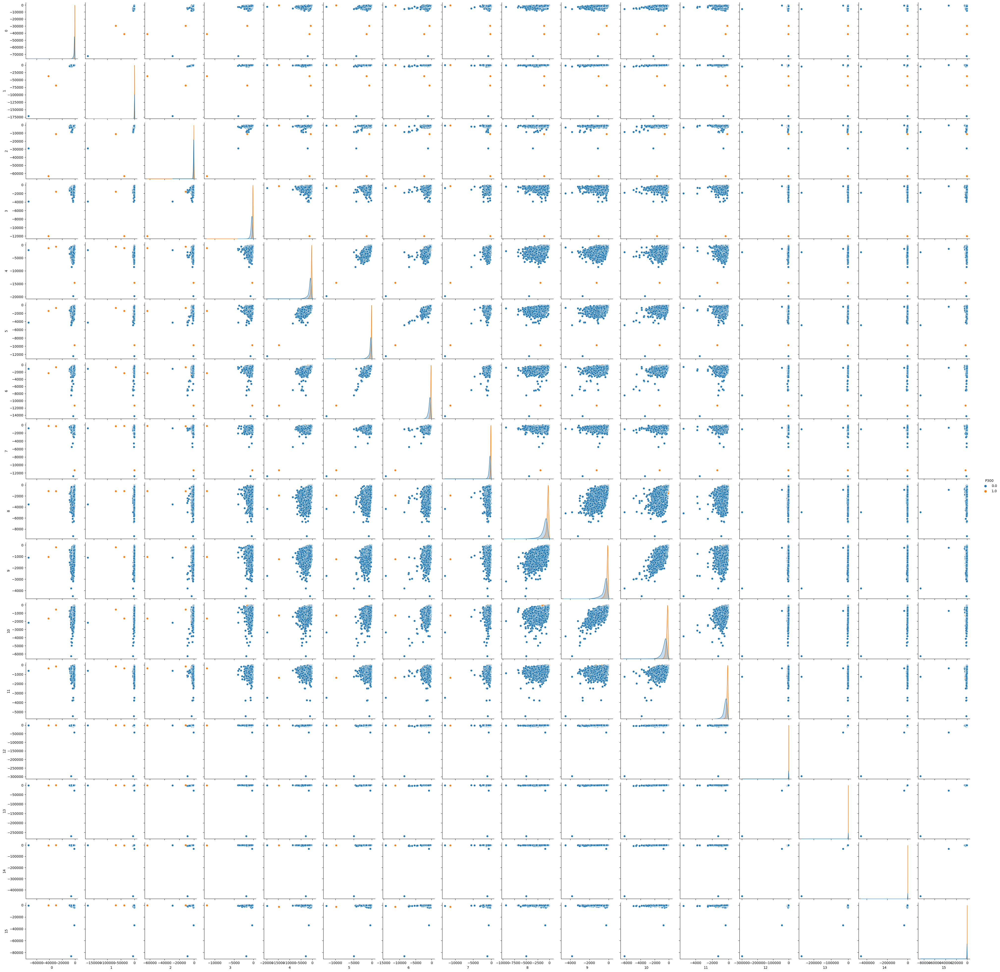

In [67]:
sns.pairplot(data_df, hue="P300", diag_kws={'bw': 0.2})

## Coeficiente de Variación por Ventana

In [68]:
def ventanas_WindCV(epochs,m1,m2,m3,m4,F):
  prom = np.mean(epochs.get_data()) # Si pongo este parametro la distribución cambia   , axis=2
  epochs_part1 = epochs.copy().crop(tmin=m1, tmax=m2)
  epochs_part2 = epochs.copy().crop(tmin=m2, tmax=m3)
  epochs_part3 = epochs.copy().crop(tmin=m3, tmax=m4)
  epochs_part4 = epochs.copy().crop(tmin=m4, tmax=F)
  data_part1 = epochs_part1.get_data()
  data_part2 = epochs_part2.get_data()
  data_part3 = epochs_part3.get_data()
  data_part4 = epochs_part4.get_data()
  mean_part1 = np.std(data_part1[:, :], axis=2)/np.mean(data_part1[:, :], axis=2)
  mean_part2 = np.std(data_part2[:, :], axis=2)/np.mean(data_part2[:, :], axis=2)
  mean_part3 = np.std(data_part3[:, :], axis=2)/np.mean(data_part3[:, :], axis=2)
  mean_part4 = np.std(data_part4[:, :], axis=2)/np.mean(data_part4[:, :], axis=2)
  return mean_part1, mean_part2, mean_part3, mean_part4

In [69]:
mean_target_part1, mean_target_part2 ,mean_target_part3 ,mean_target_part4 = ventanas_WindCV(target,-0.3,0,0.25,0.4,0.7)
mean_standard_part1, mean_standard_part2, mean_standard_part3, mean_standard_part4 = ventanas_WindCV(standard,-0.3,0,0.25,0.4,0.7)
mean_standard_part1.shape

/tmp/ipykernel_98499/94412534.py:6: RuntimeWarning: tmax is not in time interval. tmax is set to <class 'mne.epochs.EpochsFIF'>.tmax (0.688 s)
  epochs_part4 = epochs.copy().crop(tmin=m4, tmax=F)
/tmp/ipykernel_98499/94412534.py:6: RuntimeWarning: tmax is not in time interval. tmax is set to <class 'mne.epochs.EpochsFIF'>.tmax (0.688 s)
  epochs_part4 = epochs.copy().crop(tmin=m4, tmax=F)


(14835, 4)

In [70]:
featuresT = np.concatenate((mean_target_part1, mean_target_part2, mean_target_part3, mean_target_part4), axis=1)
featuresF = np.concatenate((mean_standard_part1, mean_standard_part2, mean_standard_part3, mean_standard_part4), axis=1)
labelT = np.ones([len(mean_target_part1)])
labelF = np.zeros([len(mean_standard_part1)])
features = np.concatenate((featuresT,featuresF), axis=0)
labels = np.concatenate((labelT,labelF), axis=0)

print(features.shape)
print(labels.shape)

(29670, 16)
(29670,)


In [71]:
data_df = pd.DataFrame(features)
data_df['P300'] =labels

/opt/conda/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dty

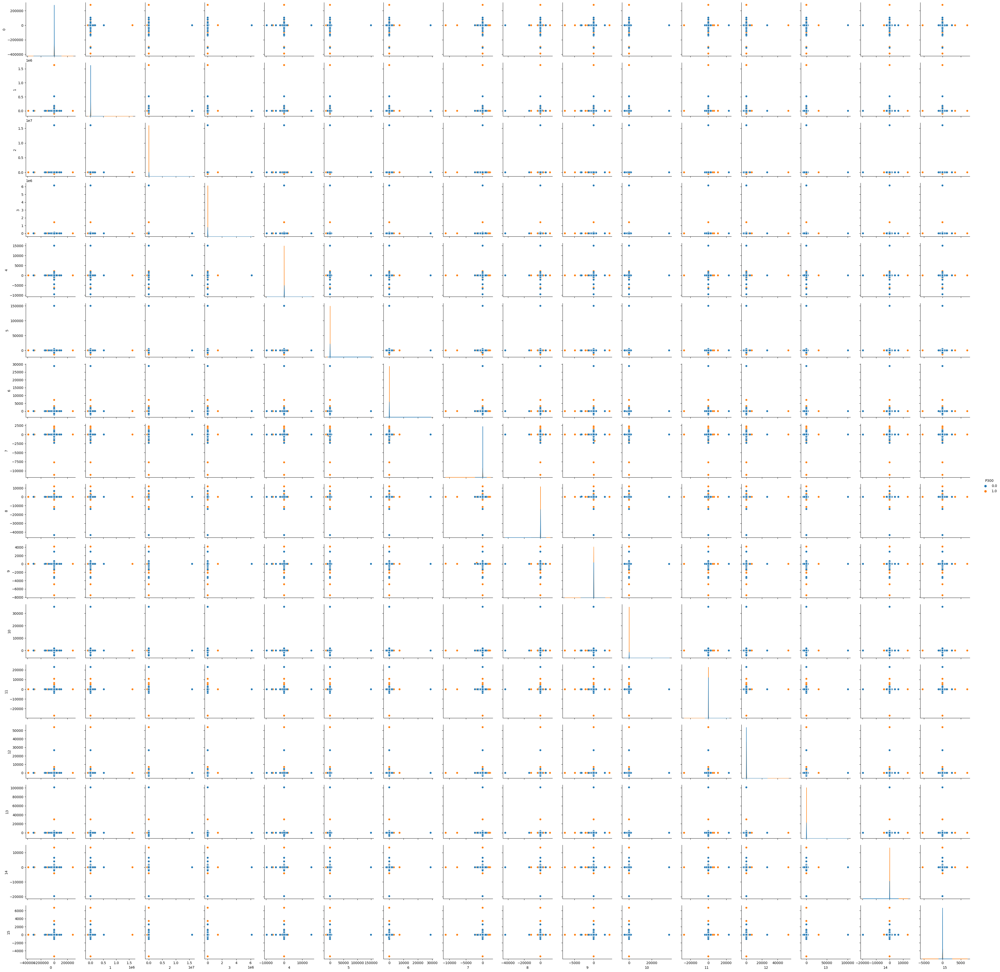

In [72]:
sns.pairplot(data_df, hue="P300", diag_kws={'bw': 0.2})

## Coeficiente de variación con media general

In [73]:
def ventanas_CVGen(media,epochs,m1,m2,m3,m4,F):
  epochs_part1 = epochs.copy().crop(tmin=m1, tmax=m2)
  epochs_part2 = epochs.copy().crop(tmin=m2, tmax=m3)
  epochs_part3 = epochs.copy().crop(tmin=m3, tmax=m4)
  epochs_part4 = epochs.copy().crop(tmin=m4, tmax=F)
  data_part1 = epochs_part1.get_data()
  data_part2 = epochs_part2.get_data()
  data_part3 = epochs_part3.get_data()
  data_part4 = epochs_part4.get_data()
  mean_part1 = np.std(data_part1[:, :], axis=2)/media
  mean_part2 = np.std(data_part2[:, :], axis=2)/media
  mean_part3 = np.std(data_part3[:, :], axis=2)/media
  mean_part4 = np.std(data_part4[:, :], axis=2)/media
  return mean_part1, mean_part2, mean_part3, mean_part4

In [74]:
media = np.mean(epochs.get_data())
mean_target_part1, mean_target_part2 ,mean_target_part3 ,mean_target_part4 = ventanas_CVGen(media,target,-0.3,0,0.25,0.4,0.7)
mean_standard_part1, mean_standard_part2, mean_standard_part3, mean_standard_part4 = ventanas_CVGen(media,standard,-0.3,0,0.25,0.4,0.7)
mean_standard_part1.shape

/tmp/ipykernel_98499/2899003652.py:5: RuntimeWarning: tmax is not in time interval. tmax is set to <class 'mne.epochs.EpochsFIF'>.tmax (0.688 s)
  epochs_part4 = epochs.copy().crop(tmin=m4, tmax=F)
/tmp/ipykernel_98499/2899003652.py:5: RuntimeWarning: tmax is not in time interval. tmax is set to <class 'mne.epochs.EpochsFIF'>.tmax (0.688 s)
  epochs_part4 = epochs.copy().crop(tmin=m4, tmax=F)


(14835, 4)

In [75]:
featuresT = np.concatenate((mean_target_part1, mean_target_part2, mean_target_part3, mean_target_part4), axis=1)
featuresF = np.concatenate((mean_standard_part1, mean_standard_part2, mean_standard_part3, mean_standard_part4), axis=1)
labelT = np.ones([len(mean_target_part1)])
labelF = np.zeros([len(mean_standard_part1)])
features = np.concatenate((featuresT,featuresF), axis=0)
labels = np.concatenate((labelT,labelF), axis=0)

print(features.shape)
print(labels.shape)

(29670, 16)
(29670,)


In [76]:
data_df = pd.DataFrame(features)
data_df['P300'] =labels

/opt/conda/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dty

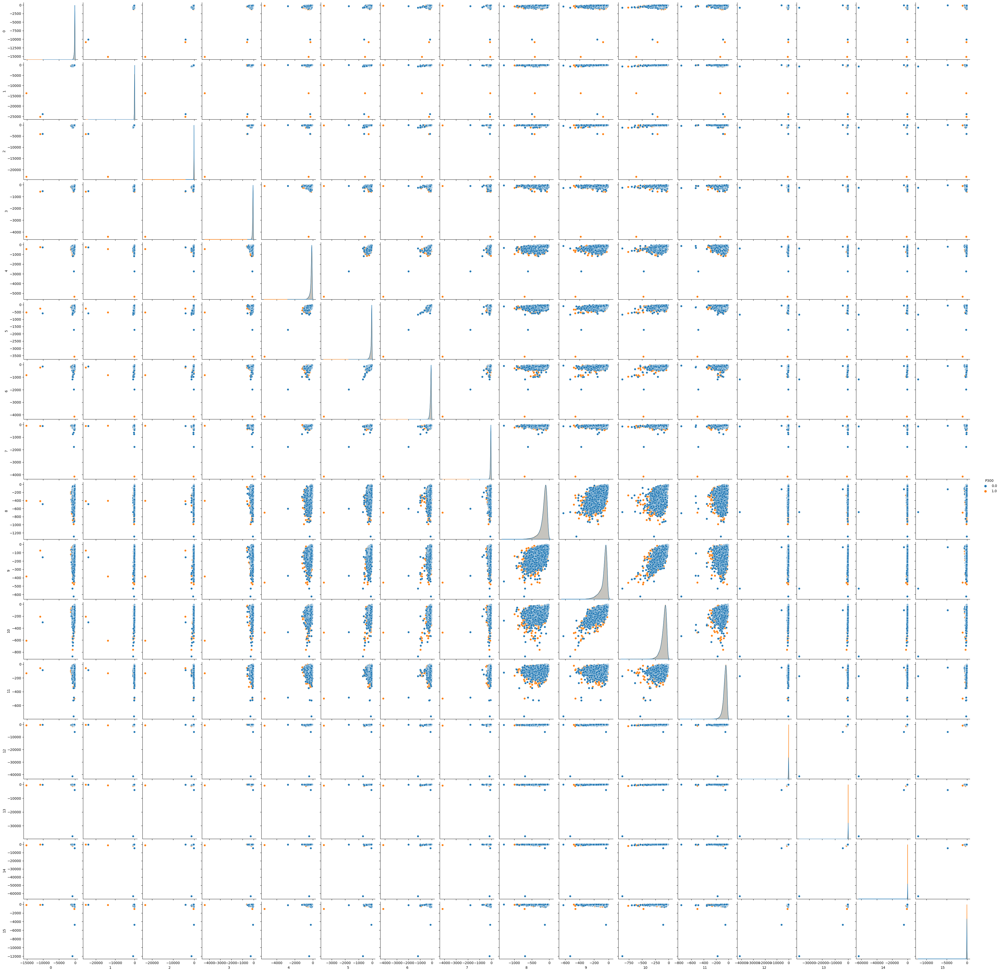

In [77]:
sns.pairplot(data_df, hue="P300", diag_kws={'bw': 0.2})

## Delta Amplitud / Delta Tiempo

In [78]:
def buscar_indice_max_min(a):
  max_indices = []
  min_indices = []
  for i in range(a.shape[1]):
    index = np.argmax(a[:, i])
    max_indices.append(index)
  for i in range(a.shape[1]):
    index = np.argmin(a[:, i])
    min_indices.append(index)
  return np.array(max_indices), np.array(min_indices)

In [79]:
def ventanas_DADT(epochs,m1,m2,m3,m4,F):
  epochs_part1 = epochs.copy().crop(tmin=m1, tmax=m2)
  epochs_part2 = epochs.copy().crop(tmin=m2, tmax=m3)
  epochs_part3 = epochs.copy().crop(tmin=m3, tmax=m4)
  epochs_part4 = epochs.copy().crop(tmin=m4, tmax=F)
  data_part1 = epochs_part1.get_data()
  data_part2 = epochs_part2.get_data()
  data_part3 = epochs_part3.get_data()
  data_part4 = epochs_part4.get_data()
  max_part1 = np.max(data_part1[:, :], axis=2)
  max_part2 = np.max(data_part2[:, :], axis=2)
  max_part3 = np.max(data_part3[:, :], axis=2)
  max_part4 = np.max(data_part4[:, :], axis=2)
  min_part1 = np.min(data_part1[:, :], axis=2)
  min_part2 = np.min(data_part2[:, :], axis=2)
  min_part3 = np.min(data_part3[:, :], axis=2)
  min_part4 = np.min(data_part4[:, :], axis=2)
  index_max_part1, index_min_part1 = buscar_indice_max_min(data_part1[:, :])
  index_max_part2, index_min_part2 = buscar_indice_max_min(data_part2[:, :])
  index_max_part3, index_min_part3 = buscar_indice_max_min(data_part3[:, :])
  index_max_part4, index_min_part4 = buscar_indice_max_min(data_part4[:, :])
  mean_part1 = (max_part1-min_part1)/(index_max_part1-index_min_part1)
  mean_part2 = (max_part2-min_part2)/(index_max_part2-index_min_part2)
  mean_part3 = (max_part3-min_part3)/(index_max_part3-index_min_part3)
  mean_part4 = (max_part4-min_part4)/(index_max_part4-index_min_part4)
  return mean_part1, mean_part2, mean_part3, mean_part4

In [80]:
mean_target_part1, mean_target_part2 ,mean_target_part3 ,mean_target_part4 = ventanas_DADT(target,-0.3,0,0.25,0.4,0.7)
mean_standard_part1, mean_standard_part2, mean_standard_part3, mean_standard_part4 = ventanas_DADT(standard,-0.3,0,0.25,0.4,0.7)
mean_standard_part1.shape

/tmp/ipykernel_98499/2774894235.py:5: RuntimeWarning: tmax is not in time interval. tmax is set to <class 'mne.epochs.EpochsFIF'>.tmax (0.688 s)
  epochs_part4 = epochs.copy().crop(tmin=m4, tmax=F)
/tmp/ipykernel_98499/2774894235.py:5: RuntimeWarning: tmax is not in time interval. tmax is set to <class 'mne.epochs.EpochsFIF'>.tmax (0.688 s)
  epochs_part4 = epochs.copy().crop(tmin=m4, tmax=F)


(14835, 4)

In [81]:
featuresT = np.concatenate((mean_target_part1, mean_target_part2, mean_target_part3, mean_target_part4), axis=1)
featuresF = np.concatenate((mean_standard_part1, mean_standard_part2, mean_standard_part3, mean_standard_part4), axis=1)
labelT = np.ones([len(mean_target_part1)])
labelF = np.zeros([len(mean_standard_part1)])
features = np.concatenate((featuresT,featuresF), axis=0)
labels = np.concatenate((labelT,labelF), axis=0)

print(features.shape)
print(labels.shape)

(29670, 16)
(29670,)


In [82]:
data_df = pd.DataFrame(features)
data_df['P300'] =labels

/opt/conda/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dty

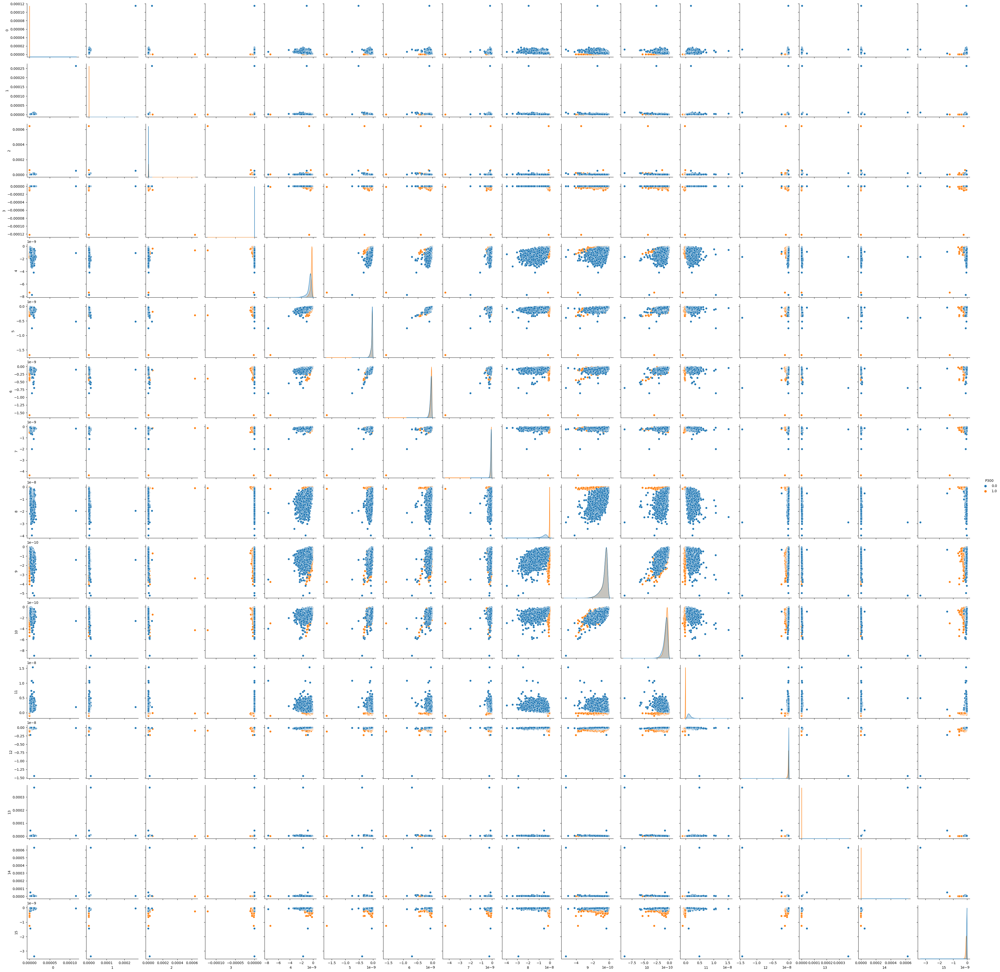

In [83]:
sns.pairplot(data_df, hue="P300", diag_kws={'bw': 0.2})

## Convolución

In [84]:
def convol(data):
  part = data[69:88]
  conv = np.convolve(part,data)
  #return np.partition(conv, len(data))[:len(data)] # Datos menores en la correlación
  return np.partition(conv, -len(data))[-len(data):] # Datos mayores en la correlación

In [85]:
a = [1,2,3,4,4,3,2,1]
b = [2,3,4]
print(np.convolve(a,b))

[ 2  7 16 25 32 34 29 20 11  4]


In [86]:
de_epochs = epochs.copy().apply_function(convol)
de_epochs['1'].plot_image(picks=['F'])#P300
de_epochs['0'].plot_image(picks=['F'])
de_epochs['1'].plot_image(picks=['C'])#P300
de_epochs['0'].plot_image(picks=['C'])
de_epochs['1'].plot_image(picks=['P'])#P300
de_epochs['0'].plot_image(picks=['P'])
de_epochs['1'].plot_image(picks=['O'])#P300
de_epochs['0'].plot_image(picks=['O'])

KeyError: 'Event name "1" could not be found. The following events are present in the data: 14, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13'

In [ ]:
def ventanas_Convo(epochs,m1,m2,m3,m4,F):
  epochs_part1 = epochs.copy().crop(tmin=m1, tmax=m2)
  epochs_part2 = epochs.copy().crop(tmin=m2, tmax=m3)
  epochs_part3 = epochs.copy().crop(tmin=m3, tmax=m4)
  epochs_part4 = epochs.copy().crop(tmin=m4, tmax=F)
  print(epochs_part1)
  data_part1 = epochs_part1.get_data()
  data_part2 = epochs_part2.get_data()
  data_part3 = epochs_part3.get_data()
  data_part4 = epochs_part4.get_data()
  mean_part1 = np.convolve(data_part1[1],data_part1[0])
  #mean_part2 = np.convolve(data_part1[:, 2],data_part2[:, 2])
  #mean_part3 = np.convolve(data_part1[:, 3],data_part3[:, 3])
  #mean_part4 = np.convolve(data_part1[:, 1],data_part4[:, 1])
  return mean_part1#, mean_part2, mean_part3, mean_part4

In [ ]:
mean_target_part1, mean_target_part2 ,mean_target_part3 ,mean_target_part4 = ventanas_Convo(target,-0.3,-0.05,0.2,0.45,0.7)
mean_standard_part1, mean_standard_part2, mean_standard_part3, mean_standard_part4 = ventanas_Convo(standard,-0.3,-0.05,0.2,0.45,0.7)
mean_standard_part1.shape

In [ ]:
featuresT = np.concatenate((mean_target_part1, mean_target_part2, mean_target_part3, mean_target_part4), axis=1)
featuresF = np.concatenate((mean_standard_part1, mean_standard_part2, mean_standard_part3, mean_standard_part4), axis=1)
labelT = np.ones([len(mean_target_part1)])
labelF = np.zeros([len(mean_standard_part1)])
features = np.concatenate((featuresT,featuresF), axis=0)
labels = np.concatenate((labelT,labelF), axis=0)

print(features.shape)
print(labels.shape)

In [ ]:
data_df = pd.DataFrame(features)
data_df['P300'] =labels

In [ ]:
sns.pairplot(data_df, hue="P300", diag_kws={'bw': 0.2})

# Derivada

In [87]:
def derivada(data):
    return np.gradient(data)

def ventanas_derivada_mean(epochs,m1,m2,m3,m4,F):
  de_epochs = epochs.copy().apply_function(derivada)
  epochs_part1 = de_epochs.copy().crop(tmin=m1, tmax=m2)
  epochs_part2 = de_epochs.copy().crop(tmin=m2, tmax=m3)
  epochs_part3 = de_epochs.copy().crop(tmin=m3, tmax=m4)
  epochs_part4 = de_epochs.copy().crop(tmin=m4, tmax=F)
  data_part1 = epochs_part1.get_data()
  data_part2 = epochs_part2.get_data()
  data_part3 = epochs_part3.get_data()
  data_part4 = epochs_part4.get_data()
  mean_part1 = np.mean(data_part1[:, :], axis=2)
  mean_part2 = np.mean(data_part2[:, :], axis=2)
  mean_part3 = np.mean(data_part3[:, :], axis=2)
  mean_part4 = np.mean(data_part4[:, :], axis=2)
  return mean_part1, mean_part2, mean_part3, mean_part4


Not setting metadata
14835 matching events found
No baseline correction applied
0 projection items activated


/tmp/ipykernel_98499/259933169.py:3: RuntimeWarning: Cannot find channel coordinates in the supplied Evokeds. Not showing channel locations.
  de_epochs['14'].plot_image(picks=['F'])#P300


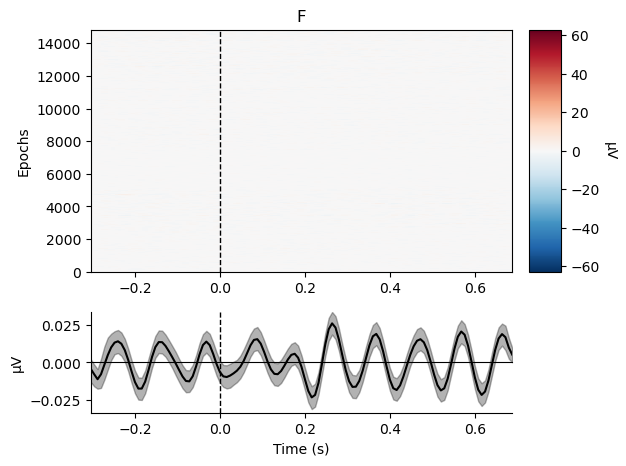

Not setting metadata
14835 matching events found
No baseline correction applied
0 projection items activated


/tmp/ipykernel_98499/259933169.py:4: RuntimeWarning: Cannot find channel coordinates in the supplied Evokeds. Not showing channel locations.
  de_epochs['2'].plot_image(picks=['F'])


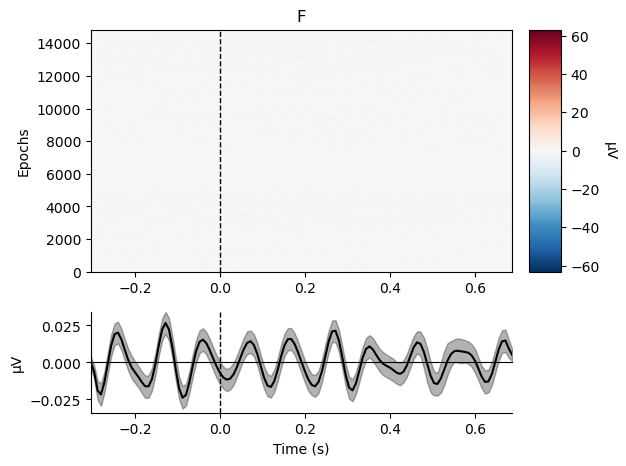

Not setting metadata
14835 matching events found
No baseline correction applied
0 projection items activated


/tmp/ipykernel_98499/259933169.py:5: RuntimeWarning: Cannot find channel coordinates in the supplied Evokeds. Not showing channel locations.
  de_epochs['14'].plot_image(picks=['C'])#P300


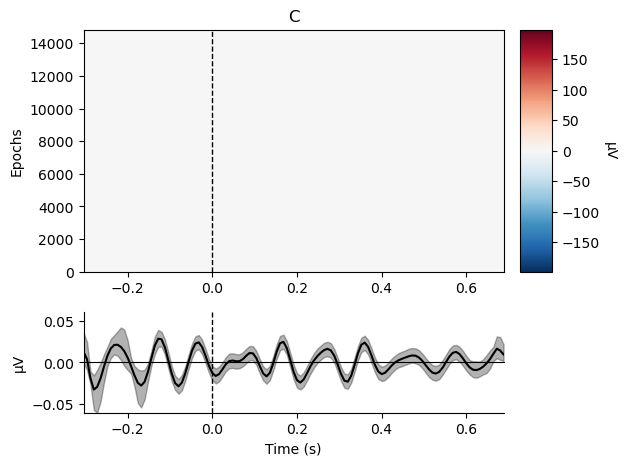

Not setting metadata
14835 matching events found
No baseline correction applied
0 projection items activated


/tmp/ipykernel_98499/259933169.py:6: RuntimeWarning: Cannot find channel coordinates in the supplied Evokeds. Not showing channel locations.
  de_epochs['2'].plot_image(picks=['C'])


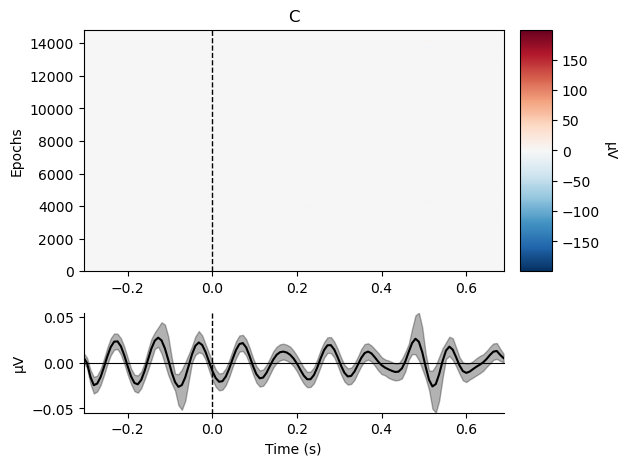

Not setting metadata
14835 matching events found
No baseline correction applied
0 projection items activated


/tmp/ipykernel_98499/259933169.py:7: RuntimeWarning: Cannot find channel coordinates in the supplied Evokeds. Not showing channel locations.
  de_epochs['14'].plot_image(picks=['P'])#P300


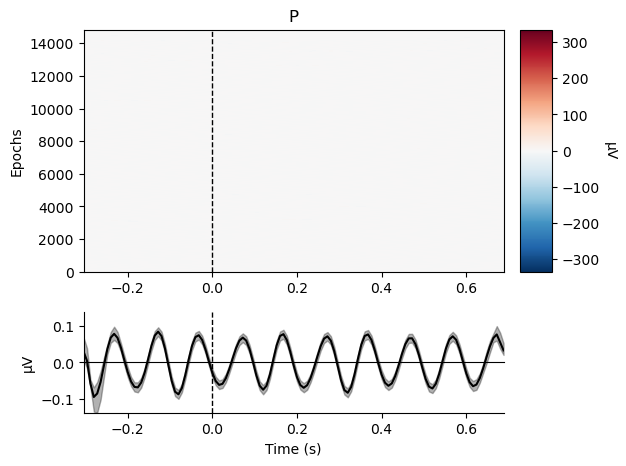

Not setting metadata
14835 matching events found
No baseline correction applied
0 projection items activated


/tmp/ipykernel_98499/259933169.py:8: RuntimeWarning: Cannot find channel coordinates in the supplied Evokeds. Not showing channel locations.
  de_epochs['2'].plot_image(picks=['P'])


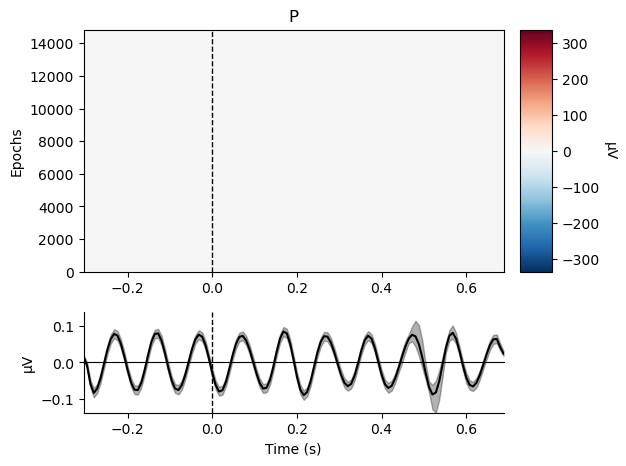

Not setting metadata
14835 matching events found
No baseline correction applied
0 projection items activated


/tmp/ipykernel_98499/259933169.py:9: RuntimeWarning: Cannot find channel coordinates in the supplied Evokeds. Not showing channel locations.
  de_epochs['14'].plot_image(picks=['O'])#P300


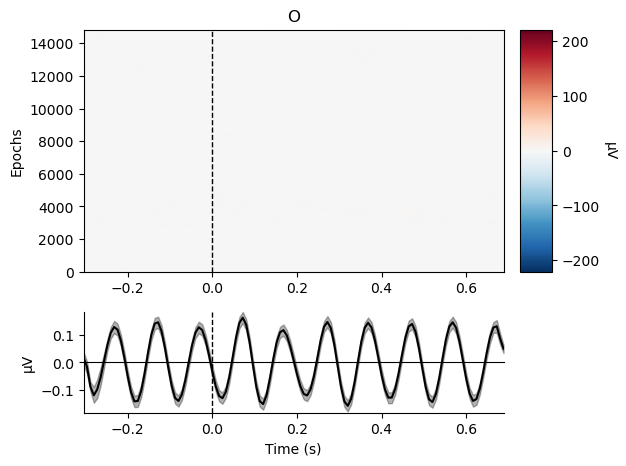

Not setting metadata
14835 matching events found
No baseline correction applied
0 projection items activated


/tmp/ipykernel_98499/259933169.py:10: RuntimeWarning: Cannot find channel coordinates in the supplied Evokeds. Not showing channel locations.
  de_epochs['2'].plot_image(picks=['O'])


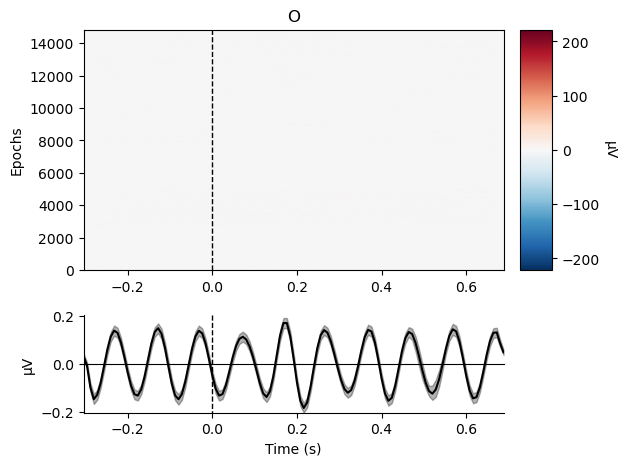

[<Figure size 640x480 with 3 Axes>]

In [89]:
de_epochs2 = epochs.copy().apply_function(derivada)
de_epochs = de_epochs2.copy().apply_function(derivada)
de_epochs['14'].plot_image(picks=['F'])#P300
de_epochs['2'].plot_image(picks=['F'])
de_epochs['14'].plot_image(picks=['C'])#P300
de_epochs['2'].plot_image(picks=['C'])
de_epochs['14'].plot_image(picks=['P'])#P300
de_epochs['2'].plot_image(picks=['P'])
de_epochs['14'].plot_image(picks=['O'])#P300
de_epochs['2'].plot_image(picks=['O'])

In [90]:
mean_target_part1, mean_target_part2 ,mean_target_part3 ,mean_target_part4 = ventanas_derivada_mean(target,-0.3,0,0.25,0.4,0.7)
mean_standard_part1, mean_standard_part2, mean_standard_part3, mean_standard_part4 = ventanas_derivada_mean(standard,-0.3,0,0.25,0.4,0.7)
mean_standard_part1.shape

/tmp/ipykernel_98499/887537551.py:9: RuntimeWarning: tmax is not in time interval. tmax is set to <class 'mne.epochs.EpochsFIF'>.tmax (0.688 s)
  epochs_part4 = de_epochs.copy().crop(tmin=m4, tmax=F)
/tmp/ipykernel_98499/887537551.py:9: RuntimeWarning: tmax is not in time interval. tmax is set to <class 'mne.epochs.EpochsFIF'>.tmax (0.688 s)
  epochs_part4 = de_epochs.copy().crop(tmin=m4, tmax=F)


(14835, 4)

In [91]:
featuresT = np.concatenate((mean_target_part1, mean_target_part2, mean_target_part3, mean_target_part4), axis=1)
featuresF = np.concatenate((mean_standard_part1, mean_standard_part2, mean_standard_part3, mean_standard_part4), axis=1)
labelT = np.ones([len(mean_target_part1)])
labelF = np.zeros([len(mean_standard_part1)])
features = np.concatenate((featuresT,featuresF), axis=0)
labels = np.concatenate((labelT,labelF), axis=0)

print(features.shape)
print(labels.shape)

(29670, 16)
(29670,)


In [92]:
data_df = pd.DataFrame(features)
data_df['P300'] =labels

/opt/conda/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dty

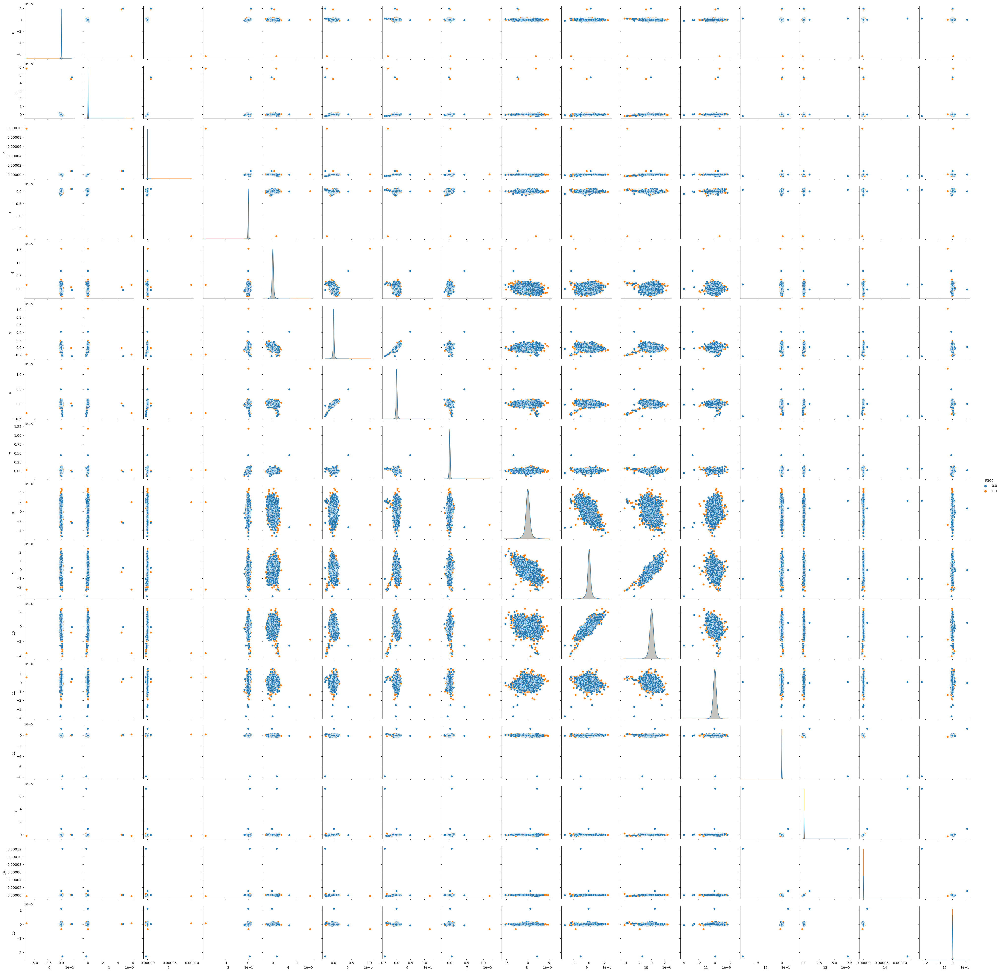

In [95]:
fig=sns.pairplot(data_df, hue="P300", diag_kws={'bw': 0.2})

## Pendiente de la derivada

In [97]:
de_epochs = epochs.copy().apply_function(derivada)
target = de_epochs["14"]#.average()
standard = de_epochs["2"]#.average()
mean_target_part1, mean_target_part2 ,mean_target_part3 ,mean_target_part4 = ventanas_DADT(target,-0.3,0,0.25,0.4,0.7)
mean_standard_part1, mean_standard_part2, mean_standard_part3, mean_standard_part4 = ventanas_DADT(standard,-0.3,0,0.25,0.4,0.7)
mean_standard_part1.shape

/tmp/ipykernel_98499/2774894235.py:5: RuntimeWarning: tmax is not in time interval. tmax is set to <class 'mne.epochs.EpochsFIF'>.tmax (0.688 s)
  epochs_part4 = epochs.copy().crop(tmin=m4, tmax=F)
/tmp/ipykernel_98499/2774894235.py:5: RuntimeWarning: tmax is not in time interval. tmax is set to <class 'mne.epochs.EpochsFIF'>.tmax (0.688 s)
  epochs_part4 = epochs.copy().crop(tmin=m4, tmax=F)


(14835, 4)

In [98]:
featuresT = np.concatenate((mean_target_part1, mean_target_part2, mean_target_part3, mean_target_part4), axis=1)
featuresF = np.concatenate((mean_standard_part1, mean_standard_part2, mean_standard_part3, mean_standard_part4), axis=1)
labelT = np.ones([len(mean_target_part1)])
labelF = np.zeros([len(mean_standard_part1)])
features = np.concatenate((featuresT,featuresF), axis=0)
labels = np.concatenate((labelT,labelF), axis=0)

print(features.shape)
print(labels.shape)

(29670, 16)
(29670,)


In [99]:
data_df = pd.DataFrame(features)
data_df['P300'] =labels

/opt/conda/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dty

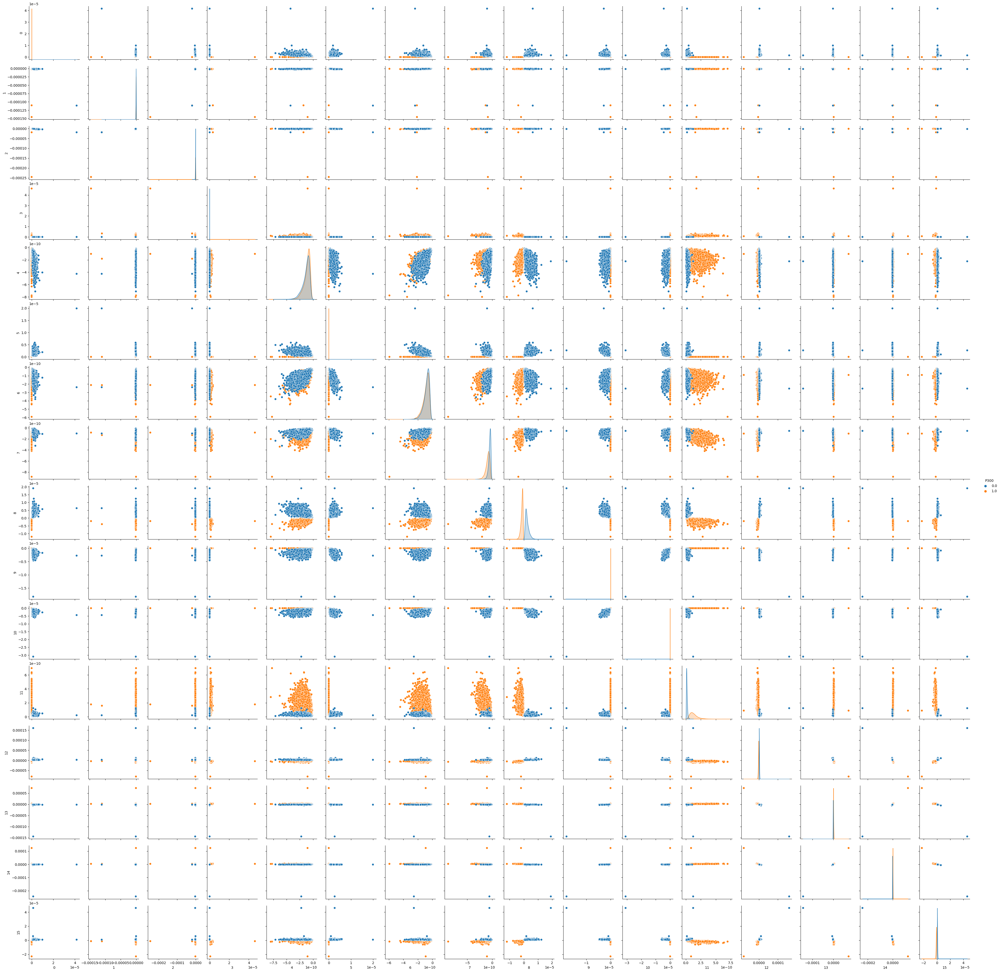

In [100]:
fig = sns.pairplot(data_df, hue="P300", diag_kws={'bw': 0.2})

## Ventana con forma

In [105]:
from scipy.stats import skewnorm
def forma_sesgo_negativo(data):
  # Create x values
  x = np.linspace(0, 125, 125)
  # Create y values
  a = 1 # Set the skewness parameter
  y = skewnorm.pdf(x, a, loc=60, scale=40)*85
  fx = data*y
  return fx

/tmp/ipykernel_98499/3706020052.py:5: RuntimeWarning: tmax is not in time interval. tmax is set to <class 'mne.epochs.EpochsFIF'>.tmax (0.688 s)
  epochs_part4 = epochs.copy().crop(tmin=m4, tmax=F)
/tmp/ipykernel_98499/3706020052.py:5: RuntimeWarning: tmax is not in time interval. tmax is set to <class 'mne.epochs.EpochsFIF'>.tmax (0.688 s)
  epochs_part4 = epochs.copy().crop(tmin=m4, tmax=F)


Not setting metadata
14835 matching events found
No baseline correction applied
0 projection items activated


/tmp/ipykernel_98499/2232247316.py:8: RuntimeWarning: Cannot find channel coordinates in the supplied Evokeds. Not showing channel locations.
  de_epochs['14'].plot_image(picks=['F'])#P300


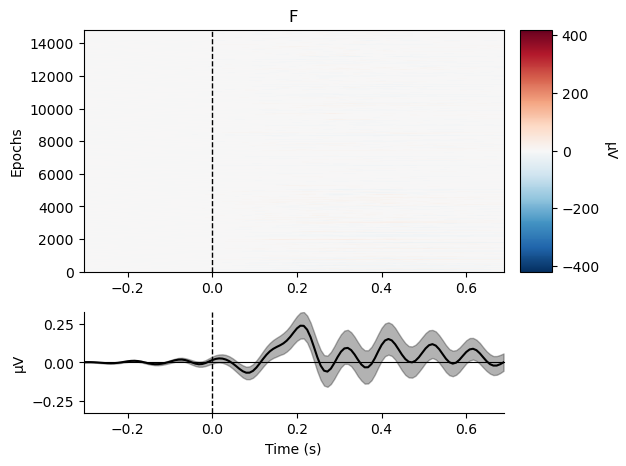

Not setting metadata
14835 matching events found
No baseline correction applied
0 projection items activated


/tmp/ipykernel_98499/2232247316.py:9: RuntimeWarning: Cannot find channel coordinates in the supplied Evokeds. Not showing channel locations.
  de_epochs['2'].plot_image(picks=['F'])


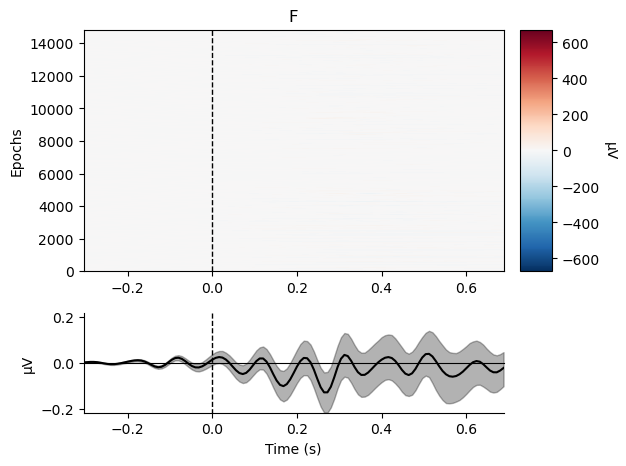

Not setting metadata
14835 matching events found
No baseline correction applied
0 projection items activated


/tmp/ipykernel_98499/2232247316.py:10: RuntimeWarning: Cannot find channel coordinates in the supplied Evokeds. Not showing channel locations.
  de_epochs['14'].plot_image(picks=['C'])#P300


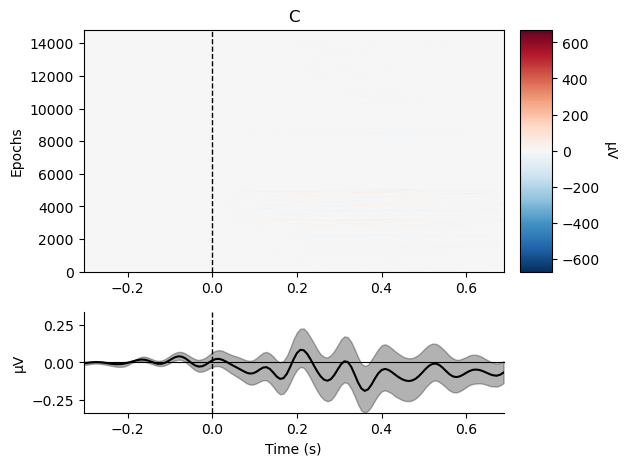

Not setting metadata
14835 matching events found
No baseline correction applied
0 projection items activated


/tmp/ipykernel_98499/2232247316.py:11: RuntimeWarning: Cannot find channel coordinates in the supplied Evokeds. Not showing channel locations.
  de_epochs['2'].plot_image(picks=['C'])


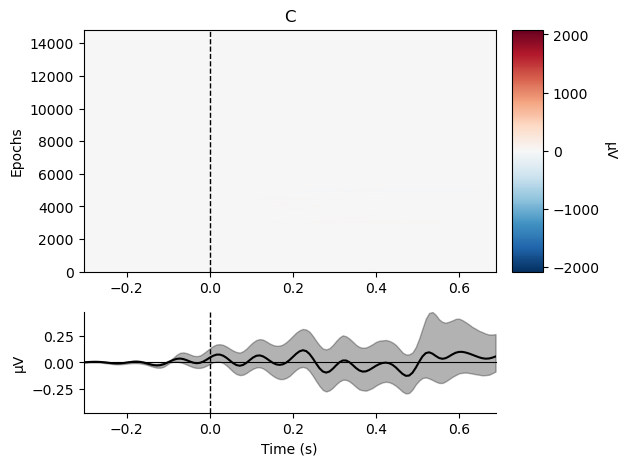

Not setting metadata
14835 matching events found
No baseline correction applied
0 projection items activated


/tmp/ipykernel_98499/2232247316.py:12: RuntimeWarning: Cannot find channel coordinates in the supplied Evokeds. Not showing channel locations.
  de_epochs['14'].plot_image(picks=['P'])#P300


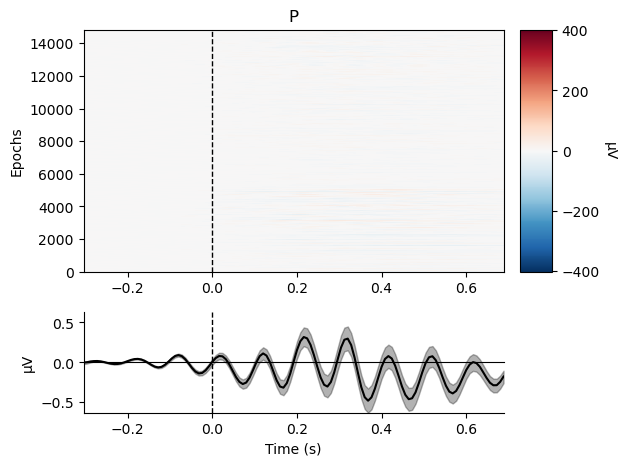

Not setting metadata
14835 matching events found
No baseline correction applied
0 projection items activated


/tmp/ipykernel_98499/2232247316.py:13: RuntimeWarning: Cannot find channel coordinates in the supplied Evokeds. Not showing channel locations.
  de_epochs['2'].plot_image(picks=['P'])


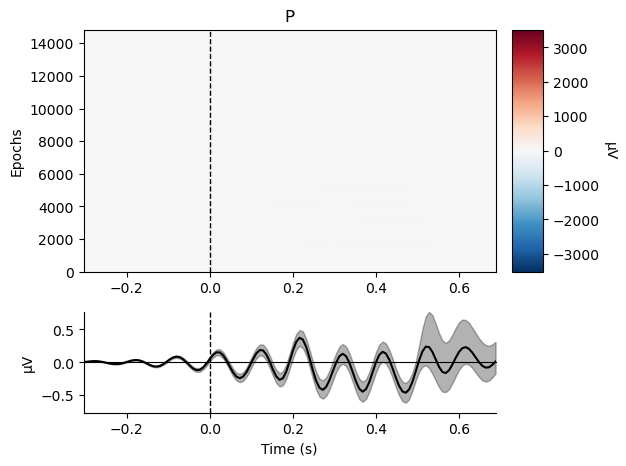

Not setting metadata
14835 matching events found
No baseline correction applied
0 projection items activated


/tmp/ipykernel_98499/2232247316.py:14: RuntimeWarning: Cannot find channel coordinates in the supplied Evokeds. Not showing channel locations.
  de_epochs['14'].plot_image(picks=['O'])#P300


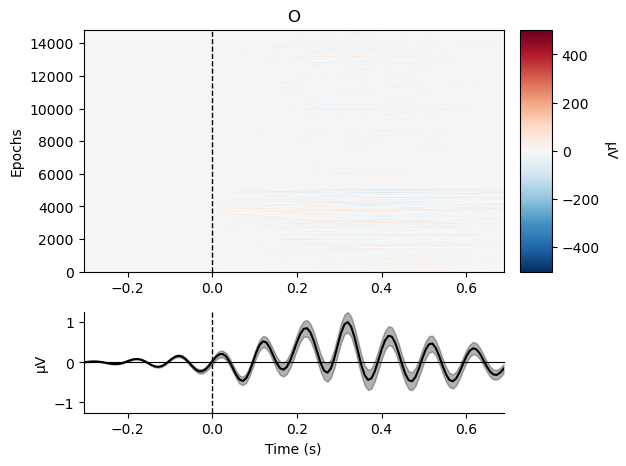

Not setting metadata
14835 matching events found
No baseline correction applied
0 projection items activated


/tmp/ipykernel_98499/2232247316.py:15: RuntimeWarning: Cannot find channel coordinates in the supplied Evokeds. Not showing channel locations.
  de_epochs['2'].plot_image(picks=['O'])


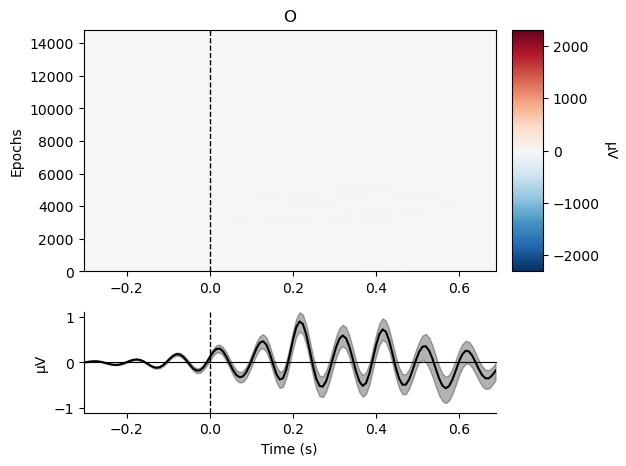

[<Figure size 640x480 with 3 Axes>]

In [109]:
de_epochs = epochs.copy().apply_function(forma_sesgo_negativo)
target = de_epochs["14"]#.average()
standard = de_epochs["2"]#.average()
mean_target_part1, mean_target_part2 ,mean_target_part3 ,mean_target_part4 = ventanas_mean(target,-0.3,0,0.25,0.4,0.7)
mean_standard_part1, mean_standard_part2, mean_standard_part3, mean_standard_part4 = ventanas_mean(standard,-0.3,0,0.25,0.4,0.7)
mean_standard_part1.shape

de_epochs['14'].plot_image(picks=['F'])#P300
de_epochs['2'].plot_image(picks=['F'])
de_epochs['14'].plot_image(picks=['C'])#P300
de_epochs['2'].plot_image(picks=['C'])
de_epochs['14'].plot_image(picks=['P'])#P300
de_epochs['2'].plot_image(picks=['P'])
de_epochs['14'].plot_image(picks=['O'])#P300
de_epochs['2'].plot_image(picks=['O'])

In [110]:
featuresT = np.concatenate((mean_target_part1, mean_target_part2, mean_target_part3, mean_target_part4), axis=1)
featuresF = np.concatenate((mean_standard_part1, mean_standard_part2, mean_standard_part3, mean_standard_part4), axis=1)
labelT = np.ones([len(mean_target_part1)])
labelF = np.zeros([len(mean_standard_part1)])
features = np.concatenate((featuresT,featuresF), axis=0)
labels = np.concatenate((labelT,labelF), axis=0)

print(features.shape)
print(labels.shape)

(29670, 16)
(29670,)


In [111]:
data_df = pd.DataFrame(features)
data_df['P300'] =labels

/opt/conda/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/opt/conda/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dty

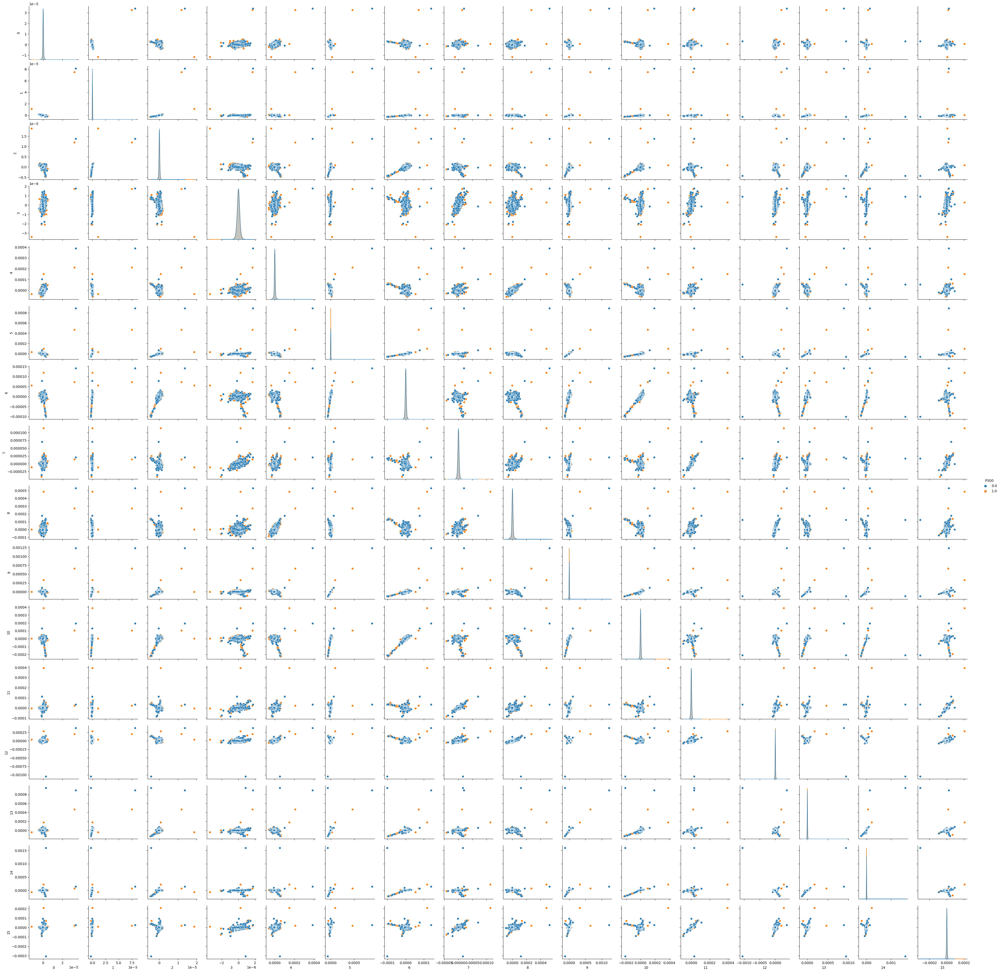

In [112]:
fig = sns.pairplot(data_df, hue="P300", diag_kws={'bw': 0.2})